<a href="https://colab.research.google.com/github/Siyun0316/AI-Data-Engineering/blob/main/HOUSTON_Crime_2019_2021_Spark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Houston Crime Analysis and Modeling** 



## 1.Introduction


This project presents a comprehensive crime data analysis and modeling for the city of Houston from 2019 to 2021. As a longtime resident of Houston, I have a personal interest in understanding the distribution and trends of crime in the city. The project aims to identify high-risk areas, visualize crime-prone locations, forecast future crime occurrences, and analyze crime rates over time.

The analysis employs various techniques for descriptive, predictive, and prescriptive purposes. The first section utilizes OLAP for crime data analysis, the second section utilizes unsupervised learning for spatial data analysis, and the final section employs time series data analysis. Together, these sections provide a thorough understanding of the crime landscape in Houston and offer insights for addressing the issue of crime in the city.



## 2.Setup Google Drive Environment & Import Data

In [ ]:
!apt install proj-bin libproj-dev libgeos-dev

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libgeos-dev is already the newest version (3.9.1-1~focal0).
libgeos-dev set to manually installed.
libproj-dev is already the newest version (7.2.1-1~focal0).
libproj-dev set to manually installed.
The following NEW packages will be installed:
  proj-bin
0 upgraded, 1 newly installed, 0 to remove and 22 not upgraded.
Need to get 170 kB of archives.
After this operation, 485 kB of additional disk space will be used.
Get:1 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal/main amd64 proj-bin amd64 7.2.1-1~focal0 [170 kB]
Fetched 170 kB in 0s (347 kB/s)
Selecting previously unselected package proj-bin.
(Reading database ... 128275 files and directories currently installed.)
Preparing to unpack .../proj-bin_7.2.1-1~focal0_amd64.deb ...
Unpacking proj-bin (7.2.1-1~focal0) ...
Setting up proj-bin (7.2.1-1~focal0) ...
Processing triggers for man-db (2.9.1-1) ...


In [ ]:
pip install pandas-bokeh

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install pgeocode

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install basemap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 864.1/864.1 KB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 56.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 48.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 KB 5.1 MB/s eta 0:00:00


In [ ]:
!pip install git+https://github.com/python-visualization/folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/python-visualization/folium to /tmp/pip-req-build-l6mnl4th
  Running command git clone --filter=blob:none --quiet https://github.com/python-visualization/folium /tmp/pip-req-build-l6mnl4th
  Resolved https://github.com/python-visualization/folium to commit cf5f834eeaeef2bdb77e8e31aa1f9498d63bf249
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for folium: filename=folium-0.14.1.dev31+gcf5f834-py2.py3-none-any.whl size=103291 sha256=b4222ac5061e91842be68f703afc09fe46d893d409e19b219a1359c5312505c7
  Stored in directory: /tmp/pip-ephem-wheel-cache-zsiztgwq/wheels/19/d6/fb/3b57939585b3aae2f03b66c6403100e5c792631b59a90cdef5
Successfully built folium
  Attempting uninstall: folium
    Found existing installation: folium 0.12.1.post1
    Uninstalling folium-0.12.1.p

In [ ]:
pip install geopy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install pyspark

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.4/281.4 MB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.7/199.7 KB 18.9 MB/s eta 0:00:00
  Created wheel for pyspark: filename=pyspark-3.3.2-py2.py3-none-any.whl size=281824025 sha256=beceb2becebab3d275049caa82462ece4284a9da52725c554f375dad9fd79f65
  Stored in directory: /root/.cache/pip/wheels/6c/e3/9b/0525ce8a69478916513509d43693511463c6468db0de237c86
Successfully built pyspark


In [ ]:
!apt-get update
!apt-get install openjdk-8-jdk-headless -qq > /dev/null

!wget -q https://dlcdn.apache.org/spark/spark-3.3.2/spark-3.3.2-bin-hadoop3.tgz

!tar xf spark-3.3.2-bin-hadoop3.tgz
!pwd
!ls /content/

Hit:1 http://archive.ubuntu.com/ubuntu focal InRelease
Get:2 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease [3,622 B]
Hit:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease
Get:5 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Ign:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  InRelease
Hit:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Get:8 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Hit:9 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu2004/x86_64  Release
Hit:10 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Hit:11 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Get:12 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1,310 kB]
Hit:13 http://ppa.launchpad.net/graphics

In [ ]:
# Set up Spark
!pip install py4j

!export JAVA_HOME=$(/usr/lib/jvm/java-8-openjdk-amd64 -v 1.8)
! echo $JAVA_HOME
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.3.2-bin-hadoop3"

# Install library for finding Spark
!pip install -q findspark
import findspark
findspark.init("spark-3.3.2-bin-hadoop3")# SPARK_HOME

# Initiate findspark
findspark.init()
# Check the location for Spark
findspark.find()


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/bin/bash: /usr/lib/jvm/java-8-openjdk-amd64: Is a directory



'spark-3.3.2-bin-hadoop3'

In [ ]:
from pyspark.sql import SparkSession
spark = SparkSession.builder.master("local[*]").getOrCreate()
spark.conf.set('spark.sql.legacy.timeParserPolicy', 'LEGACY')

In [ ]:
!ls
spark.version

sample_data  spark-3.3.2-bin-hadoop3  spark-3.3.2-bin-hadoop3.tgz


'3.3.2'

In [ ]:
from csv import reader
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import os

import pandas_bokeh
pandas_bokeh.output_notebook()


from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

import scipy.stats as stats
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_process import arma_generate_sample, ArmaProcess
sns.set_palette([ "#30a2da", "#fc4f30", "#e5ae38", "#6d904f", "#8b8b8b"])

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

link = 'https://drive.google.com/file/d/1SaJZPRSqEjdx7bgyFAvLdA1NAfpDKyHM'

fluff, id = link.split('/d/')
file = drive.CreateFile({'id':id}) 
file.GetContentFile('houston_crime.csv') 
hou_crm_df = pd.read_csv('houston_crime.csv')

from pyspark.sql import Row 
from pyspark.sql import SparkSession
from pyspark.sql.types import *
hou_crm_sdf = spark.read.csv('houston_crime.csv',inferSchema=True, header =True)


In [ ]:
hou_crm_sdf.printSchema()
hou_crm_sdf.dtypes

root
 |-- Incident: integer (nullable = true)
 |-- Occurrence Date: string (nullable = true)
 |-- OccurrenceHour: integer (nullable = true)
 |-- NIBRSClass: string (nullable = true)
 |-- NIBRSDescription: string (nullable = true)
 |-- OffenseCount: integer (nullable = true)
 |-- Beat: string (nullable = true)
 |-- Premise: string (nullable = true)
 |-- BlockRange: string (nullable = true)
 |-- StreetName: string (nullable = true)
 |-- StreetType: string (nullable = true)
 |-- Suffix: string (nullable = true)
 |-- City: string (nullable = true)
 |-- ZIPCode: string (nullable = true)



[('Incident', 'int'),
 ('Occurrence Date', 'string'),
 ('OccurrenceHour', 'int'),
 ('NIBRSClass', 'string'),
 ('NIBRSDescription', 'string'),
 ('OffenseCount', 'int'),
 ('Beat', 'string'),
 ('Premise', 'string'),
 ('BlockRange', 'string'),
 ('StreetName', 'string'),
 ('StreetType', 'string'),
 ('Suffix', 'string'),
 ('City', 'string'),
 ('ZIPCode', 'string')]

In [ ]:
hou_crm_sdf.show()

+--------+---------------+--------------+----------+--------------------+------------+--------+--------------------+----------+----------+----------+------+-------+----------+
|Incident|Occurrence Date|OccurrenceHour|NIBRSClass|    NIBRSDescription|OffenseCount|    Beat|             Premise|BlockRange|StreetName|StreetType|Suffix|   City|   ZIPCode|
+--------+---------------+--------------+----------+--------------------+------------+--------+--------------------+----------+----------+----------+------+-------+----------+
|    5619|       1/1/2019|             0|       290|Destruction, dama...|           1|    9C30|Residence, Home (...|      9622|SAN CARLOS|      null|  null|HOUSTON|     77013|
|   17319|       1/1/2019|             0|       35A|Drug, narcotic vi...|           1|    7C10|Highway, Road, St...|      null|      EAST|       FWY|  null|HOUSTON|     77020|
|   18119|       1/1/2019|             0|       290|Destruction, dama...|           1|1.60E+41|Residence, Home (...|    

In [ ]:
hou_crm_sdf.registerTempTable("hou_crm_sql")

/content/spark-3.3.2-bin-hadoop3/python/pyspark/sql/dataframe.py:229: FutureWarning: Deprecated in 2.0, use createOrReplaceTempView instead.
  warnings.warn("Deprecated in 2.0, use createOrReplaceTempView instead.", FutureWarning)


## 3: Data Exploration

###3.1.Raw Data QC

The provided dataset has different “features”, each one being of a different relevance. In this part I will proceed to analyse this dataset and extract the useful information out of it. Each record contains the following information:

INCIDENT: Internal Houston Police Department report number

NIBRSClass: Numerical code of offense description

NIBRSDescription: Internal categorization of Offense type. https://ucr.fbi.gov/nibrs/2011/resources/nibrs-offense-codes/view

Offense Count: Number of offenses committed. Quantified by NIBRS rules. 

BEAT: Beat where the offense occurred.  https://www.houstontx.gov/police/pdfs/hpd_beat_map.pdf

PRMISE:  Type of location where the offense occurred.

DISTRICT: What district the crime was reported in

Block Range: Hundred block for address where offense occurred.

Street Name: Street name where offense occurred.

Street Type: Identifiers of street names. {e.g. R=Road, ST=Street, DR=Drive, AVE-Avenue}

Suffix [Streets] Text Directional identifiers for streets. {e.g., E=East, W=West, S=South, N=North}

In [ ]:
hou_crm_sdf.count()

713924

In [ ]:
hou_crm_sdf.distinct().count()

713924

In [ ]:
hou_crm_sdf.describe().show()


+-------+-------------------+---------------+------------------+------------------+------------------+-------------------+--------------------+--------------------+-----------------+----------------+----------+------+------------------+------------------+
|summary|           Incident|Occurrence Date|    OccurrenceHour|        NIBRSClass|  NIBRSDescription|       OffenseCount|                Beat|             Premise|       BlockRange|      StreetName|StreetType|Suffix|              City|           ZIPCode|
+-------+-------------------+---------------+------------------+------------------+------------------+-------------------+--------------------+--------------------+-----------------+----------------+----------+------+------------------+------------------+
|  count|             713924|         713924|            713924|            713924|            713924|             713924|              713443|              713923|           711787|          713924|    657751|103375|            713

In [ ]:
hou_crm_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 713924 entries, 0 to 713923
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Incident          713924 non-null  int64 
 1   Occurrence Date   713924 non-null  object
 2   OccurrenceHour    713924 non-null  int64 
 3   NIBRSClass        713924 non-null  object
 4   NIBRSDescription  713924 non-null  object
 5   OffenseCount      713924 non-null  int64 
 6   Beat              713443 non-null  object
 7   Premise           713923 non-null  object
 8   BlockRange        711787 non-null  object
 9   StreetName        713924 non-null  object
 10  StreetType        657751 non-null  object
 11  Suffix            103375 non-null  object
 12  City              713924 non-null  object
 13  ZIPCode           705625 non-null  object
dtypes: int64(3), object(11)
memory usage: 76.3+ MB


In [ ]:
hou_crm_sdf.columns

['Incident',
 'Occurrence Date',
 'OccurrenceHour',
 'NIBRSClass',
 'NIBRSDescription',
 'OffenseCount',
 'Beat',
 'Premise',
 'BlockRange',
 'StreetName',
 'StreetType',
 'Suffix',
 'City',
 'ZIPCode']

In [ ]:
rename_dict = {"Occurrence Date": "Date", "OccurrenceHour": "Hour","NIBRSClass":"Class","BlockRange":"Block"}
for old_name, new_name in rename_dict.items():
    hou_crm_sdf = hou_crm_sdf.withColumnRenamed(old_name, new_name)

hou_crm_sdf.columns

['Incident',
 'Date',
 'Hour',
 'Class',
 'NIBRSDescription',
 'OffenseCount',
 'Beat',
 'Premise',
 'Block',
 'StreetName',
 'StreetType',
 'Suffix',
 'City',
 'ZIPCode']


###3.2.Data Processing: locations

**Fully prepared for the spatial data analysis**

>convert address to latitude and longitude coordinates

>convert zipcode to coordinates if required




In [ ]:
from pyspark.sql.functions import concat_ws, col
# Define the columns for the Street address
col1 = ['StreetName', 'StreetType']
hou_crm_sdf = hou_crm_sdf.withColumn("Street", concat_ws(' ', *[col(c) for c in col1]))
hou_crm_sdf = hou_crm_sdf.drop(*col1)
# Define the columns for the full Address
cols = ['Street', 'City', 'ZIPCode']
hou_crm_sdf = hou_crm_sdf.withColumn("Address", concat_ws(',', *[col(c) for c in cols]))

hou_crm_sdf.show()

+--------+--------+----+-----+--------------------+------------+--------+--------------------+-----+------+-------+----------+-------------+--------------------+
|Incident|    Date|Hour|Class|    NIBRSDescription|OffenseCount|    Beat|             Premise|Block|Suffix|   City|   ZIPCode|       Street|             Address|
+--------+--------+----+-----+--------------------+------------+--------+--------------------+-----+------+-------+----------+-------------+--------------------+
|    5619|1/1/2019|   0|  290|Destruction, dama...|           1|    9C30|Residence, Home (...| 9622|  null|HOUSTON|     77013|   SAN CARLOS|SAN CARLOS,HOUSTO...|
|   17319|1/1/2019|   0|  35A|Drug, narcotic vi...|           1|    7C10|Highway, Road, St...| null|  null|HOUSTON|     77020|     EAST FWY|EAST FWY,HOUSTON,...|
|   18119|1/1/2019|   0|  290|Destruction, dama...|           1|1.60E+41|Residence, Home (...|16718|  null|HOUSTON|     77489|LONE QUAIL CT|LONE QUAIL CT,HOU...|
|   19019|1/1/2019|   0|  52

In [ ]:
from pyspark.sql.functions import substring

# Cast the ZIPCode column to string and take the first 5 characters
hou_crm_sdf = hou_crm_sdf.withColumn("ZIPCode", substring(col("ZIPCode").cast("string"), 1, 5))

# Show the summary statistics of the ZIPCode column
hou_crm_sdf.select("ZIPCode").describe().show()

+-------+------------------+
|summary|           ZIPCode|
+-------+------------------+
|  count|            705625|
|   mean|  77060.4196931798|
| stddev|107.85660108682418|
|    min|             36551|
|    max|             98004|
+-------+------------------+



In [ ]:
hou_crm_sdf.dtypes

[('Incident', 'int'),
 ('Date', 'string'),
 ('Hour', 'int'),
 ('Class', 'string'),
 ('NIBRSDescription', 'string'),
 ('OffenseCount', 'int'),
 ('Beat', 'string'),
 ('Premise', 'string'),
 ('Block', 'string'),
 ('Suffix', 'string'),
 ('City', 'string'),
 ('ZIPCode', 'string'),
 ('Street', 'string'),
 ('Address', 'string')]

In [ ]:
# Cast the ZIPCode column to numeric with nulls for non-numeric values
hou_crm_sdf = hou_crm_sdf.withColumn("ZIPCode", col("ZIPCode").cast("integer"))

# Show the summary statistics of the ZIPCode column
hou_crm_sdf.select("ZIPCode").describe().show()

+-------+------------------+
|summary|           ZIPCode|
+-------+------------------+
|  count|            705625|
|   mean|  77060.4196931798|
| stddev|107.85660108682418|
|    min|             36551|
|    max|             98004|
+-------+------------------+



In [ ]:
hou_crm_sdf.dtypes


[('Incident', 'int'),
 ('Date', 'string'),
 ('Hour', 'int'),
 ('Class', 'string'),
 ('NIBRSDescription', 'string'),
 ('OffenseCount', 'int'),
 ('Beat', 'string'),
 ('Premise', 'string'),
 ('Block', 'string'),
 ('Suffix', 'string'),
 ('City', 'string'),
 ('ZIPCode', 'int'),
 ('Street', 'string'),
 ('Address', 'string')]

In [ ]:
# Houston Zip Code range 77002~77598
from pyspark.sql.functions import when

# Replace values less than 77001 and greater than 77600 with nulls
hou_crm_sdf = hou_crm_sdf.withColumn("ZIPCode", when((col("ZIPCode") < 77001) | (col("ZIPCode") > 77600), None).otherwise(col("ZIPCode")))

# Show the summary statistics of the ZIPCode column
hou_crm_sdf.select("ZIPCode").describe().show()

+-------+-----------------+
|summary|          ZIPCode|
+-------+-----------------+
|  count|           705584|
|   mean|77060.51546236876|
| stddev|77.96427477645307|
|    min|            77002|
|    max|            77598|
+-------+-----------------+



In [ ]:
from pyspark.sql.functions import isnan,count

# Count the number of null values in the ZIPCode column
null_count = hou_crm_sdf.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in hou_crm_sdf.columns]).select("ZIPCode").collect()[0][0]

# Calculate the percentage of null values in the ZIPCode column
null_percentage = null_count / hou_crm_sdf.count() * 100

# Print the results
print('Out of Houston Zipcode count: ' + str(int(null_count)))
print('Out of Houston Zipcode percentage%: ' + str(round(null_percentage, 2)))

Out of Houston Zipcode count: 8340
Out of Houston Zipcode percentage%: 1.17


**Comments:**
> Approximately 1.17% of crimes have ZIPCodes located outside of Houston. Therefore, we will exclude those data from our analysis.

In [ ]:
from pyspark.sql.functions import regexp_extract
# Remove add-on codes from the ZIPCode column
hou_crm_sdf = hou_crm_sdf.withColumn('ZIPCode', regexp_extract('ZIPCode', r'^(\d{5})', 1))

# Drop rows with null values in the ZIPCode column
hou_crm_sdf = hou_crm_sdf.na.drop(subset=['ZIPCode'])

# Check for null values in the DataFrame
null_counts = hou_crm_sdf.select([count(when(col(c).isNull(), c)).alias(c) for c in hou_crm_sdf.columns])

# Print the null counts for each column
null_counts.show()

+--------+----+----+-----+----------------+------------+----+-------+-----+------+----+-------+------+-------+
|Incident|Date|Hour|Class|NIBRSDescription|OffenseCount|Beat|Premise|Block|Suffix|City|ZIPCode|Street|Address|
+--------+----+----+-----+----------------+------------+----+-------+-----+------+----+-------+------+-------+
|       0|   0|   0|    0|               0|           0|  54|      1| 1576|602517|   0|      0|     0|      0|
+--------+----+----+-----+----------------+------------+----+-------+-----+------+----+-------+------+-------+



**Comments:**
> The suffix [street] has the highest number of null values, which is expected since not all streets have a suffix. However, we are also missing a significant amount of other address-related data such as Beat, Street Type, Zip, and more.

In [ ]:
# define upload to google drive function
def save_gdrive(data_frame, work, parts):
  
  rows = data_frame.count() // parts
  print('number of rows per file : ' + str(rows))
  data_frame2 = data_frame.toPandas()
  for i in range(parts + 1):
    s = i * rows
    e = (i + 1) * rows
    
    # write the subset to a csv file
    subname = work +"_p" + str(i) +".csv"
    data_frame2[int(s):int(e)].to_csv(subname)
   

    print('file' + str(i) + ' start at : ' + str(s))
    print('file' + str(i) + ' end at : ' + str(e))
    
    gfile = drive.CreateFile({"parents": [{'id': '1dZvuD9mhHtrA4ReUOR2QXt9aqThc0XpY'}]})
    # Read file and set it as the content of this instance.
    gfile.SetContentFile(subname)
    gfile.Upload() # Upload the file.

In [ ]:
hou_crm_sdf = hou_crm_sdf_stp1

In [ ]:
## save the hou_crm_sdf
save_gdrive(hou_crm_sdf,"hou_crm_sdf_st1",5)

## backup the hou_crm_sdf
hou_crm_sdf_stp1 = hou_crm_sdf


number of rows per file : 141116
file0 start at : 0
file0 end at : 141116
file1 start at : 141116
file1 end at : 282232
file2 start at : 282232
file2 end at : 423348
file3 start at : 423348
file3 end at : 564464
file4 start at : 564464
file4 end at : 705580
file5 start at : 705580
file5 end at : 846696


In [ ]:
print((hou_crm_sdf.count(), len(hou_crm_sdf.columns)))

In [ ]:
import math
import random
import time
from random import randint
from time import sleep
from geopy.extra.rate_limiter import RateLimiter
from geopy.geocoders import Nominatim

#Without rate limiting, will hit rate limits on the Geocoding service. 
#Therefore, rate limiting can help to reduce the number of requests made and prevent errors.

def geocode(address):
    geolocator = Nominatim(user_agent=f"geoapiExercises_{random.randint(0,1000)}", timeout=10)
    geocode = RateLimiter(geolocator.geocode, max_retries=3, error_wait_seconds=random.uniform(1, 2))
    location = geocode(address)
    if location:
        return (location.latitude, location.longitude)
    else:
        return (None, None)

def batch_geocode(wait_time_batch, wait_time_retries, data_df, batch_size, address_column, unique_array_pos, end_pos):
  unique = data_df.select(address_column).distinct().rdd.flatMap(lambda x: x).collect()
  un_size = len(unique)
  n_iter = math.ceil(un_size / batch_size) #compute the n of iterations necessary

  start_time = time.time()
  print('size: '+str(un_size))
  print('n_iter: '+str(n_iter))
  final = []

  for i in range(unique_array_pos, end_pos, 1):
    try:
      start_iter = time.time()
      if i == 0:
        start = i
      else:
        start = i * batch_size
      print('batch:'+str(i)+', row number:'+str(start))
      temp1 = unique[start:(i+1) * batch_size]

      loc = [geocode(x) for x in temp1]
      loc_lat = []
      loc_log = []

      for l in loc:
          loc_lat.append(l[0])
          loc_log.append(l[1])

      temp2 = [(temp1[i], loc_lat[i], loc_log[i]) for i in range(len(temp1))]
      final.extend(temp2)

      sleep(randint(1*100, wait_time_batch*100)/100)

      print(f'iteration time: {time.time()-start_iter:.2f}' + f', total time: {time.time()-start_time:.2f}'+ f', complete time: {time.time():.2f}')
    except GeocoderServiceError as e: 
      print(e)
      print('failed execution, last position in unique array: '+str(unique_array_pos+i*batch_size))
      return spark.createDataFrame(final, ['Address', 'Latitude', 'Longitude'])
  return spark.createDataFrame(final, ['Address', 'Latitude', 'Longitude'])


In [ ]:
unique = hou_crm_sdf.select(col('Address')).distinct().rdd.flatMap(lambda x: x).collect()
un_size = len(unique)
n_iter = math.ceil(un_size / 500) #compute the n of iterations necessary
print('size: '+str(un_size))
print('n_iter: '+str(n_iter))

size: 16873
n_iter: 34


In [ ]:
# convert the first 10 batches
loc_sdf1 = batch_geocode(5,5,hou_crm_sdf,500,"Address", 0,10)

size: 16873
n_iter: 34
batch:0, row number:0
iteration time: 261.00, total time: 261.00, complete time: 1678052516.75
batch:1, row number:500
iteration time: 257.56, total time: 518.57, complete time: 1678052774.31
batch:2, row number:1000
iteration time: 255.44, total time: 774.01, complete time: 1678053029.76
batch:3, row number:1500
iteration time: 257.99, total time: 1032.00, complete time: 1678053287.75
batch:4, row number:2000
iteration time: 255.92, total time: 1287.92, complete time: 1678053543.67
batch:5, row number:2500
iteration time: 256.41, total time: 1544.33, complete time: 1678053800.08
batch:6, row number:3000
iteration time: 257.26, total time: 1801.59, complete time: 1678054057.33
batch:7, row number:3500
iteration time: 254.15, total time: 2055.74, complete time: 1678054311.48
batch:8, row number:4000
iteration time: 257.63, total time: 2313.37, complete time: 1678054569.11
batch:9, row number:4500
iteration time: 255.65, total time: 2569.02, complete time: 16780548

In [ ]:
# convert the second 10 batches
loc_sdf2 = batch_geocode(5,5,hou_crm_sdf,500,"Address", 10,20)

size: 16873
n_iter: 34
batch:10, row number:5000
iteration time: 252.52, total time: 252.52, complete time: 1678055080.82
batch:11, row number:5500
iteration time: 257.71, total time: 510.23, complete time: 1678055338.53
batch:12, row number:6000
iteration time: 255.26, total time: 765.49, complete time: 1678055593.79
batch:13, row number:6500
iteration time: 259.46, total time: 1024.95, complete time: 1678055853.26
batch:14, row number:7000
iteration time: 253.24, total time: 1278.19, complete time: 1678056106.50
batch:15, row number:7500
iteration time: 257.31, total time: 1535.50, complete time: 1678056363.81
batch:16, row number:8000
iteration time: 258.30, total time: 1793.80, complete time: 1678056622.10
batch:17, row number:8500
iteration time: 259.72, total time: 2053.52, complete time: 1678056881.82
batch:18, row number:9000
iteration time: 253.86, total time: 2307.38, complete time: 1678057135.68
batch:19, row number:9500
iteration time: 255.29, total time: 2562.67, complete 

In [ ]:
# convert the last 14 batches
loc_sdf3 = batch_geocode(5,5,hou_crm_sdf,500,"Address", 20,34)

size: 16873
n_iter: 34
batch:20, row number:10000
iteration time: 254.66, total time: 254.66, complete time: 1678057648.88
batch:21, row number:10500
iteration time: 256.53, total time: 511.19, complete time: 1678057905.40
batch:22, row number:11000
iteration time: 260.34, total time: 771.52, complete time: 1678058165.74
batch:23, row number:11500
iteration time: 254.18, total time: 1025.71, complete time: 1678058419.93
batch:24, row number:12000
iteration time: 254.58, total time: 1280.29, complete time: 1678058674.51
batch:25, row number:12500
iteration time: 263.33, total time: 1543.62, complete time: 1678058937.84
batch:26, row number:13000
iteration time: 257.79, total time: 1801.41, complete time: 1678059195.63
batch:27, row number:13500
iteration time: 256.39, total time: 2057.80, complete time: 1678059452.02
batch:28, row number:14000
iteration time: 255.01, total time: 2312.81, complete time: 1678059707.03
batch:29, row number:14500
iteration time: 258.63, total time: 2571.44,

In [ ]:
save_gdrive(loc_sdf1,"lat_log_loc_sdf1",1)
save_gdrive(loc_sdf2,"lat_log_loc_sdf2",1)
save_gdrive(loc_sdf3,"lat_log_loc_sdf3",1)

number of rows per file : 5000
file0 start at : 0
file0 end at : 5000
file1 start at : 5000
file1 end at : 10000
number of rows per file : 5000
file0 start at : 0
file0 end at : 5000
file1 start at : 5000
file1 end at : 10000
number of rows per file : 6873
file0 start at : 0
file0 end at : 6873
file1 start at : 6873
file1 end at : 13746


In [ ]:
# Union all Spark DataFrames into a single DataFrame
loc_sdf_mrg = loc_sdf1.union(loc_sdf2).union(loc_sdf3)

# Select the required columns and display the top rows
loc_sdf_mrg.select(col('Address'), col('Latitude'), col('Longitude')).show(5)

+--------------------+----------+-----------+
|             Address|  Latitude|  Longitude|
+--------------------+----------+-----------+
|SANTA CHRISTI DR,...| 29.583867| -95.476838|
|BELLFORT AVE,HOUS...|29.6608518|-95.6009043|
|DORCHESTER ST,HOU...| 29.823076| -95.332368|
|COTTAGE GATE LN,H...| 29.884806| -95.428049|
|WOODSPRING ACRES ...| 30.075715| -95.171261|
+--------------------+----------+-----------+
only showing top 5 rows



In [ ]:
loc_sdf_mrg.describe().show()

+-------+--------------------+------------------+------------------+
|summary|             Address|          Latitude|         Longitude|
+-------+--------------------+------------------+------------------+
|  count|               16873|             15112|             15112|
|   mean|                null| 29.86408345685249|-95.26705746689717|
| stddev|                null|1.2941406980147392|2.6026126472338595|
|    min|- 8400 WEDNESBURY...|        -4.8458498|       -149.820176|
|    max|ZORA ST,HOUSTON,7...|        61.6190566|        11.4864045|
+-------+--------------------+------------------+------------------+



In [ ]:
loc_sdf_mrg.count()

16873

In [ ]:
loc_sdf_mrg.schema

StructType([StructField('Address', StringType(), True), StructField('Latitude', DoubleType(), True), StructField('Longitude', DoubleType(), True)])

In [ ]:
# Cast 'Latitude' and 'Longitude' columns to FloatType
loc_sdf_mrg = loc_sdf_mrg.withColumn('Latitude', col('Latitude').cast(FloatType()))
loc_sdf_mrg = loc_sdf_mrg.withColumn('Longitude', col('Longitude').cast(FloatType()))

In [ ]:
loc_df_mrg.astype({'Latitude':'float32',
                  'Longitude':'float32'}).dtypes


In [ ]:
# Examine the rows that cannot be converted by Nominatim
loc_sdf_mrg.select([count(when(col(c).isNull(), c)).alias(c) for c in loc_df_mrg_sdf.columns]).show()

In [ ]:
# Combine to full dataframe
hou_crm_sdf = hou_crm_sdf_stp1
hou_crm_sdf = hou_crm_sdf.join(loc_sdf_mrg, on='Address', how='left')
hou_crm_sdf.show()

+--------------------+---------+---------+----+-----+--------------------+------------+--------+--------------------+-----+------+-------+-------+----------------+----------+-----------+
|             Address| Incident|     Date|Hour|Class|    NIBRSDescription|OffenseCount|    Beat|             Premise|Block|Suffix|   City|ZIPCode|          Street|  Latitude|  Longitude|
+--------------------+---------+---------+----+-----+--------------------+------------+--------+--------------------+-----+------+-------+-------+----------------+----------+-----------+
|BESSEMER ST,HOUST...|109835420|8/20/2020|   0|  13A|  Aggravated Assault|           1|   12D10|Residence, Home (...|10537|  null|HOUSTON|  77034|     BESSEMER ST| 29.637713|-95.2328373|
|BISSONNET ST,HOUS...|109836220|8/20/2020|   0|  13A|  Aggravated Assault|           1|   19G40| Parking Lot, Garage|11905|  null|HOUSTON|  77099|    BISSONNET ST|29.6754488|-95.5917007|
|BRAESWOOD BLVD,HO...|109829620|8/20/2020|   0|  13A|  Aggravated

In [ ]:
hou_crm_sdf = hou_crm_sdf_stp2

In [ ]:
save_gdrive(hou_crm_sdf,"hou_crm_sdf_st2",5)

hou_crm_sdf_stp2 = hou_crm_sdf


number of rows per file : 141116
file0 start at : 0
file0 end at : 141116
file1 start at : 141116
file1 end at : 282232
file2 start at : 282232
file2 end at : 423348
file3 start at : 423348
file3 end at : 564464
file4 start at : 564464
file4 end at : 705580
file5 start at : 705580
file5 end at : 846696


In [ ]:
print((hou_crm_sdf.count(), len(hou_crm_sdf.columns)))

(705584, 16)


In [ ]:
hou_crm_sdf.schema

StructType([StructField('Address', StringType(), True), StructField('Incident', StringType(), True), StructField('Date', StringType(), True), StructField('Hour', StringType(), True), StructField('Class', StringType(), True), StructField('NIBRSDescription', StringType(), True), StructField('OffenseCount', StringType(), True), StructField('Beat', StringType(), True), StructField('Premise', StringType(), True), StructField('Block', StringType(), True), StructField('City', StringType(), True), StructField('ZIPCode', StringType(), True), StructField('Street', StringType(), True), StructField('Latitude', StringType(), True), StructField('Longitude', StringType(), True)])

In [ ]:
from pyspark.sql.functions import col
hou_crm_sdf = hou_crm_sdf.withColumn("Latitude", col("Latitude").cast("float")) \
                         .withColumn("Longitude", col("Longitude").cast("float"))

# Print the data types of the columns
print(hou_crm_sdf.dtypes)

[('Address', 'string'), ('Incident', 'string'), ('Date', 'string'), ('Hour', 'string'), ('Class', 'string'), ('NIBRSDescription', 'string'), ('OffenseCount', 'string'), ('Beat', 'string'), ('Premise', 'string'), ('Block', 'string'), ('City', 'string'), ('ZIPCode', 'string'), ('Street', 'string'), ('Latitude', 'float'), ('Longitude', 'float')]


In [ ]:
from pyspark.sql.functions import count,when
# Check for null values in the DataFrame
null_counts = hou_crm_sdf.select([count(when(col(c).isNull(), c)).alias(c) for c in hou_crm_sdf.columns])

# Print the null counts for each column
null_counts.show()

+-------+--------+----+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+
|Address|Incident|Date|Hour|Class|NIBRSDescription|OffenseCount|Beat|Premise|Block|City|ZIPCode|Street|Latitude|Longitude|
+-------+--------+----+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+
|      0|       0|   0|   0|    0|               0|           0|  54|      1| 1576|   0|      0|     0|   21378|    21378|
+-------+--------+----+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+



In [ ]:
# pgeocode functions can directly to the dataframe, or use it with apply functions.
hou_crm_df = hou_crm_sdf.toPandas()
hou_crm_df.isnull().sum()

Address                 0
Incident                0
Date                    0
Hour                    0
Class                   0
NIBRSDescription        0
OffenseCount            0
Beat                   54
Premise                 1
Block                1576
City                    0
ZIPCode                 0
Street                  0
Latitude            21378
Longitude           21378
dtype: int64

In [ ]:
# Use pgeocode to convert Zipcode to coordinates
# pgeocode functions can directly to the dataframe, or use it with apply functions.
import pgeocode


nomi = pgeocode.Nominatim('us')

hou_crm_df.Latitude.fillna((nomi.query_postal_code(hou_crm_df['ZIPCode'].tolist()).latitude),inplace=True)
hou_crm_df.Longitude.fillna((nomi.query_postal_code(hou_crm_df['ZIPCode'].tolist()).longitude),inplace=True)

hou_crm_df.isnull().sum()



Address                0
Incident               0
Date                   0
Hour                   0
Class                  0
NIBRSDescription       0
OffenseCount           0
Beat                  54
Premise                1
Block               1576
City                   0
ZIPCode                0
Street                 0
Latitude               0
Longitude              0
dtype: int64

In [ ]:
hou_crm_df.describe()

,Latitude,Longitude
count,705584.000000,705584.000000
mean,29.800554,-95.377357
std,0.708597,1.033172
min,-4.845850,-149.820175
25%,29.689968,-95.506966
50%,29.741596,-95.401993
75%,29.815872,-95.337852
max,61.619057,11.486404


** Comments:**
> There are some inaccuracies in the Latitude and Longitude figures. Therefore, we will replace those values with Zip code conversions.




In [ ]:
# Houston Latitde range 77002~77598 & Longitude range 
# Houston Latitude and longitude coordinates are: 29.749907, -95.358421.

hou_crm_df['Latitude'] = np.where((hou_crm_df['Latitude'] < 29)|(hou_crm_df['Latitude'] >30), nomi.query_postal_code(hou_crm_df['ZIPCode'].tolist()).latitude , hou_crm_df['Latitude'])

hou_crm_df['Longitude'] = np.where((hou_crm_df['Longitude'] > -95)|(hou_crm_df['Longitude'] < -96), nomi.query_postal_code(hou_crm_df['ZIPCode'].tolist()).longitude , hou_crm_df['Longitude'])

In [ ]:
hou_crm_df.describe()


,Latitude,Longitude
count,705584.000000,705584.000000
mean,29.753990,-95.415923
std,0.092005,0.116116
min,28.863600,-96.274300
25%,29.689205,-95.507637
50%,29.740599,-95.402534
75%,29.809849,-95.339806
max,30.498000,-94.675900


In [ ]:
#Back to spark dataframe
hou_crm_sdf = spark.createDataFrame(hou_crm_df)

In [ ]:
hou_crm_sdf.describe().show()

+-------+--------------------+--------------------+--------+------------------+------------------+------------------+------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+-------------------+
|summary|             Address|            Incident|    Date|              Hour|             Class|  NIBRSDescription|      OffenseCount|                Beat|             Premise|            Block|     City|          ZIPCode|              Street|           Latitude|          Longitude|
+-------+--------------------+--------------------+--------+------------------+------------------+------------------+------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+-------------------+
|  count|              705584|              705584|  705584|            705584|            705584|            705584|            705584|      

> The coordinates are now prepared for spatial analysis.





In [ ]:
# save and backup the dataframe
save_gdrive(hou_crm_sdf,"hou_crm_sdf_step3",5)

hou_crm_sdf_stp3 = hou_crm_sdf

number of rows per file : 141116
file0 start at : 0
file0 end at : 141116
file1 start at : 141116
file1 end at : 282232
file2 start at : 282232
file2 end at : 423348
file3 start at : 423348
file3 end at : 564464
file4 start at : 564464
file4 end at : 705580
file5 start at : 705580
file5 end at : 846696


In [ ]:
print((hou_crm_sdf.count(), len(hou_crm_sdf.columns)))

(705584, 15)


###3.3.Data Processing: Date & Time

**Fully prepared for the time series analysis**



In [ ]:
hou_crm_sdf.schema

StructType([StructField('Address', StringType(), True), StructField('Incident', StringType(), True), StructField('Date', StringType(), True), StructField('Hour', StringType(), True), StructField('Class', StringType(), True), StructField('NIBRSDescription', StringType(), True), StructField('OffenseCount', StringType(), True), StructField('Beat', StringType(), True), StructField('Premise', StringType(), True), StructField('Block', StringType(), True), StructField('City', StringType(), True), StructField('ZIPCode', StringType(), True), StructField('Street', StringType(), True), StructField('Latitude', StringType(), True), StructField('Longitude', StringType(), True)])

In [ ]:
print((hou_crm_sdf.count(), len(hou_crm_sdf.columns)))

(705584, 15)


In [ ]:
hou_crm_sdf.show(5)

+--------------------+---------+----------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------------+------------------+------------------+
|             Address| Incident|      Date|Hour|Class|    NIBRSDescription|OffenseCount| Beat|             Premise|Block|   City|ZIPCode|              Street|          Latitude|         Longitude|
+--------------------+---------+----------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------------+------------------+------------------+
|TRAVIS ST,HOUSTON...| 47486321| 4/10/2021|  18|  90Z|  All other offenses|           1| 1A10|Highway, Road, St...| 1600|HOUSTON|  77002|           TRAVIS ST|29.761648178100586|-95.36251831054688|
|MARTIN LUTHER KIN...|127347820| 9/25/2020|  19|  23H|   All other larceny|           1|14D40|Residence, Home (...|12000|HOUSTON|  77048|MARTIN LUTHER KIN...|  29.6949405670166|-95.33785247802734|
|SIMMONS,HOUSTO

In [ ]:
import pyspark.sql.functions as F
from pyspark.sql.types import DateType
from pyspark.sql.functions import to_date

# Convert string Date column to DateType column
hou_crm_sdf = hou_crm_sdf.withColumn("Date", to_date(hou_crm_sdf.Date, "MM/dd/yyyy"))

# Extract year, month, day, and dayofweek from the Date column
hou_crm_sdf = hou_crm_sdf.withColumn('year', F.year('Date')) \
                         .withColumn('month', F.month('Date')) \
                         .withColumn('day', F.dayofmonth('Date')) \
                         .withColumn('dayofweek', F.dayofweek('Date'))


# 方法1 使用系统自带udf
# from pyspark.sql.functions import to_date, to_timestamp, hour
# df_opt1 = df_opt1.withColumn('Date', to_date(df_opt1.OccurredOn, "MM/dd/yy"))
# df_opt1 = df_opt1.withColumn('Time', to_timestamp(df_opt1.OccurredOn, "MM/dd/yy HH:mm"))
# df_opt1 = df_opt1.withColumn('Hour', hour(df_opt1['Time']))
# df_opt1 = df_opt1.withColumn("DayOfWeek", date_format(df_opt1.Date, "EEEE"))

# Set the index column as Date
hou_crm_sdf = hou_crm_sdf.withColumn('index', F.col('Date')).drop('Date').withColumnRenamed('index', 'Date')

# Show the first five rows
hou_crm_sdf.show(5)

+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------------+------------------+------------------+----+-----+---+---------+----------+
|             Address| Incident|Hour|Class|    NIBRSDescription|OffenseCount| Beat|             Premise|Block|   City|ZIPCode|              Street|          Latitude|         Longitude|year|month|day|dayofweek|      Date|
+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------------+------------------+------------------+----+-----+---+---------+----------+
|TRAVIS ST,HOUSTON...| 47486321|  18|  90Z|  All other offenses|           1| 1A10|Highway, Road, St...| 1600|HOUSTON|  77002|           TRAVIS ST|29.761648178100586|-95.36251831054688|2021|    4| 10|        7|2021-04-10|
|MARTIN LUTHER KIN...|127347820|  19|  23H|   All other larceny|           1|14D40|Residence, Home (...|12000|HO

In [ ]:
!ls


hou_crm_sdf_st2_p0.csv	hou_crm_sdf_st3_p3.csv	  houston_crime.csv
hou_crm_sdf_st2_p1.csv	hou_crm_sdf_st3_p4.csv	  sample_data
hou_crm_sdf_st2_p2.csv	hou_crm_sdf_st3_p5.csv	  spark-3.3.2-bin-hadoop3
hou_crm_sdf_st2_p3.csv	hou_crm_sdf_step3_p0.csv  spark-3.3.2-bin-hadoop3.tgz
hou_crm_sdf_st2_p4.csv	hou_crm_sdf_step3_p1.csv  spark-3.3.2-bin-hadoop3.tgz.1
hou_crm_sdf_st2_p5.csv	hou_crm_sdf_step3_p2.csv  spark-3.3.2-bin-hadoop3.tgz.2
hou_crm_sdf_st3_p0.csv	hou_crm_sdf_step3_p3.csv  spark-3.3.2-bin-hadoop3.tgz.3
hou_crm_sdf_st3_p1.csv	hou_crm_sdf_step3_p4.csv
hou_crm_sdf_st3_p2.csv	hou_crm_sdf_step3_p5.csv


In [ ]:
!rm hou_crm_sdf_st2_p*.csv

In [ ]:
!rm hou_crm_sdf_st3_p*.csv

In [ ]:
!ls

hou_crm_sdf_step3_p0.csv  sample_data
hou_crm_sdf_step3_p1.csv  spark-3.3.2-bin-hadoop3
hou_crm_sdf_step3_p2.csv  spark-3.3.2-bin-hadoop3.tgz
hou_crm_sdf_step3_p3.csv  spark-3.3.2-bin-hadoop3.tgz.1
hou_crm_sdf_step3_p4.csv  spark-3.3.2-bin-hadoop3.tgz.2
hou_crm_sdf_step3_p5.csv  spark-3.3.2-bin-hadoop3.tgz.3
houston_crime.csv


In [ ]:
from pyspark.sql.functions import count,when,col
# Check for null values in the DataFrame
null_counts = hou_crm_sdf.select([count(when(col(c).isNull(), c)).alias(c) for c in hou_crm_sdf.columns])

# Print the null counts for each column
null_counts.show()

+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+
|Address|Incident|Hour|Class|NIBRSDescription|OffenseCount|Beat|Premise|Block|City|ZIPCode|Street|Latitude|Longitude|year|month|day|dayofweek|Date|
+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+
|      0|       0|   0|    0|               0|           0|  54|      1| 1576|   0|      0|     0|       0|        0|   0|    0|  0|        0|   0|
+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+



In [ ]:
# save and backup the dataframe
save_gdrive(hou_crm_sdf,"hou_crm_sdf_step4",5)

hou_crm_sdf_cp4 = hou_crm_sdf

number of rows per file : 141116
file0 start at : 0
file0 end at : 141116
file1 start at : 141116
file1 end at : 282232
file2 start at : 282232
file2 end at : 423348
file3 start at : 423348
file3 end at : 564464
file4 start at : 564464
file4 end at : 705580
file5 start at : 705580
file5 end at : 846696


In [ ]:
!ls

hou_crm_sdf_step3_p0.csv  hou_crm_sdf_step4_p4.csv
hou_crm_sdf_step3_p1.csv  hou_crm_sdf_step4_p5.csv
hou_crm_sdf_step3_p2.csv  houston_crime.csv
hou_crm_sdf_step3_p3.csv  sample_data
hou_crm_sdf_step3_p4.csv  spark-3.3.2-bin-hadoop3
hou_crm_sdf_step3_p5.csv  spark-3.3.2-bin-hadoop3.tgz
hou_crm_sdf_step4_p0.csv  spark-3.3.2-bin-hadoop3.tgz.1
hou_crm_sdf_step4_p1.csv  spark-3.3.2-bin-hadoop3.tgz.2
hou_crm_sdf_step4_p2.csv  spark-3.3.2-bin-hadoop3.tgz.3
hou_crm_sdf_step4_p3.csv


In [ ]:
hou_crm_sdf.describe().show()

+-------+--------------------+-------------------+------------------+------------------+------------------+-------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+-------------------+------------------+------------------+------------------+------------------+----------+
|summary|             Address|           Incident|              Hour|             Class|  NIBRSDescription|       OffenseCount|                Beat|             Premise|            Block|     City|          ZIPCode|              Street|           Latitude|          Longitude|              year|             month|               day|         dayofweek|      Date|
+-------+--------------------+-------------------+------------------+------------------+------------------+-------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+----------------

###3.4.Data Analysis


####3.4.1 Top 10 Crime count by category 



**Crime count by category**

In [ ]:
from pyspark.sql.functions import desc
# Group by NIBRSDescription, count the number of occurrences, and sort in descending order
crime_count_sdf = hou_crm_sdf.groupby("NIBRSDescription").count().sort(desc("count"))

# Show the top 10 results
crime_count_sdf.show(10)

+--------------------+-----+
|    NIBRSDescription|count|
+--------------------+-----+
|Theft from motor ...|83369|
|      Simple assault|75938|
|Destruction, dama...|66904|
|   All other larceny|52090|
|        Intimidation|51613|
|Burglary, Breakin...|45861|
|  Aggravated Assault|44799|
| Motor vehicle theft|42665|
|         Shoplifting|32407|
|  All other offenses|28112|
+--------------------+-----+
only showing top 10 rows



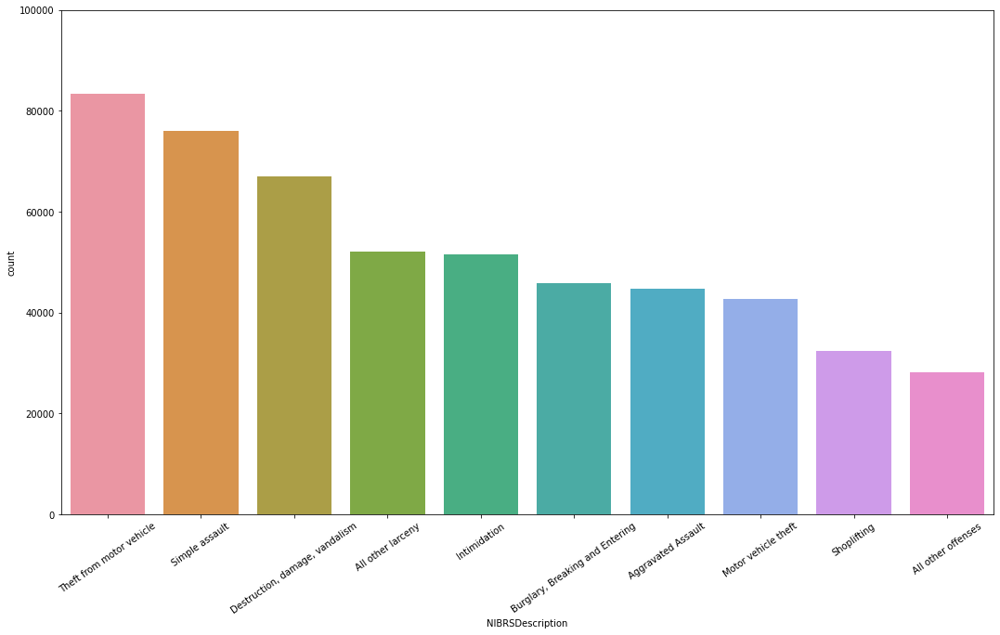

In [ ]:
# Convert Spark DataFrame to pandas DataFrame
crime_count_df = crime_count_sdf.toPandas()

# Create barplot using seaborn
plt.figure(figsize=(18,10))
sns.barplot(x="NIBRSDescription", y="count", data=crime_count_df.head(10))
plt.ylim(0, 100000)
plt.xticks(rotation=35)
plt.show()

####3.4.2 Top 10 Crime count by street
**Crime count by Street Name**

In [ ]:
# Group by StreetName, count the number of occurrences, and sort in descending order
street_count_sdf = hou_crm_sdf.groupby("Street").count().sort(desc("count"))

street_count_sdf.show(10)


+----------------+-----+
|          Street|count|
+----------------+-----+
|   WESTHEIMER RD|19493|
|        GULF FWY|10302|
|       NORTH FWY| 9359|
|SAM HOUSTON PKWY| 9150|
|    RICHMOND AVE| 9147|
|      GESSNER RD| 7980|
|            LOOP| 7965|
|         MAIN ST| 7833|
|        KATY FWY| 7316|
|    BISSONNET ST| 7261|
+----------------+-----+
only showing top 10 rows



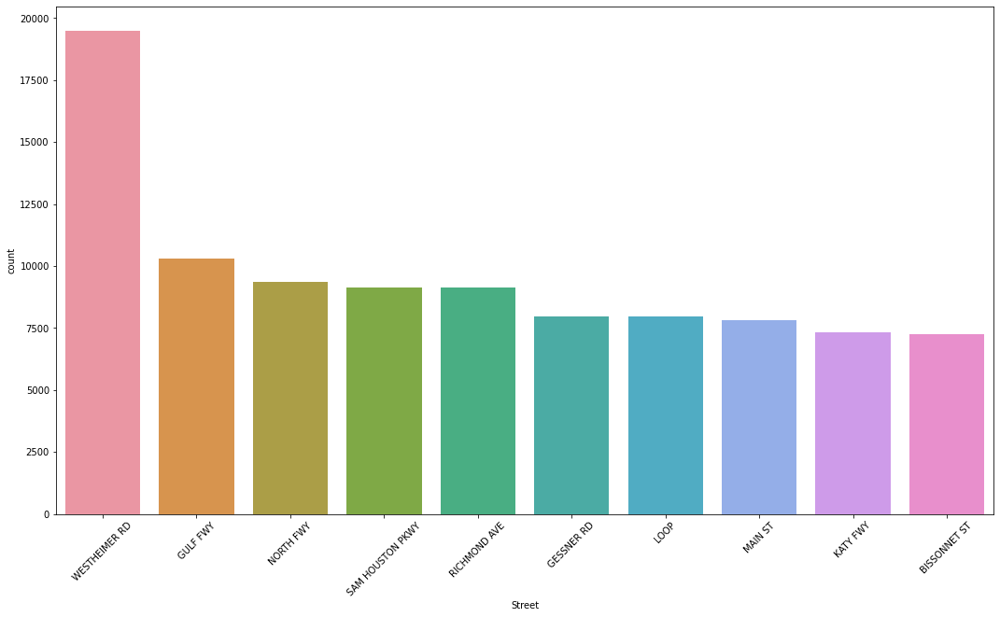

In [ ]:
# Select top 10 streets with the highest crime count
street_count_top10 = street_count_sdf.limit(10).toPandas()

# Create barplot using seaborn
# Create a bar plot of the top 10 Street with the highest crime count
plt.figure(figsize=(18,10))
sns.barplot(x="Street", y="count", data=street_count_top10)
plt.ylim(0)
plt.xticks(rotation=45)
plt.show()

#### 3.4.3 Top 10 Crime count by Zip code
**Crime count by Zip code**

In [ ]:
# Group by ZIPCode, count the number of occurrences, and sort in descending order
zipcode_count_sdf = hou_crm_sdf.groupBy("ZIPCode").count().sort(desc("count"))

# Show top 10 ZIP codes with the highest crime count
zipcode_count_sdf.show(10)

+-------+-----+
|ZIPCode|count|
+-------+-----+
|  77036|27200|
|  77092|16121|
|  77004|15812|
|  77063|15428|
|  77021|15132|
|  77057|14770|
|  77042|14634|
|  77002|14607|
|  77072|14511|
|  77077|14481|
+-------+-----+
only showing top 10 rows



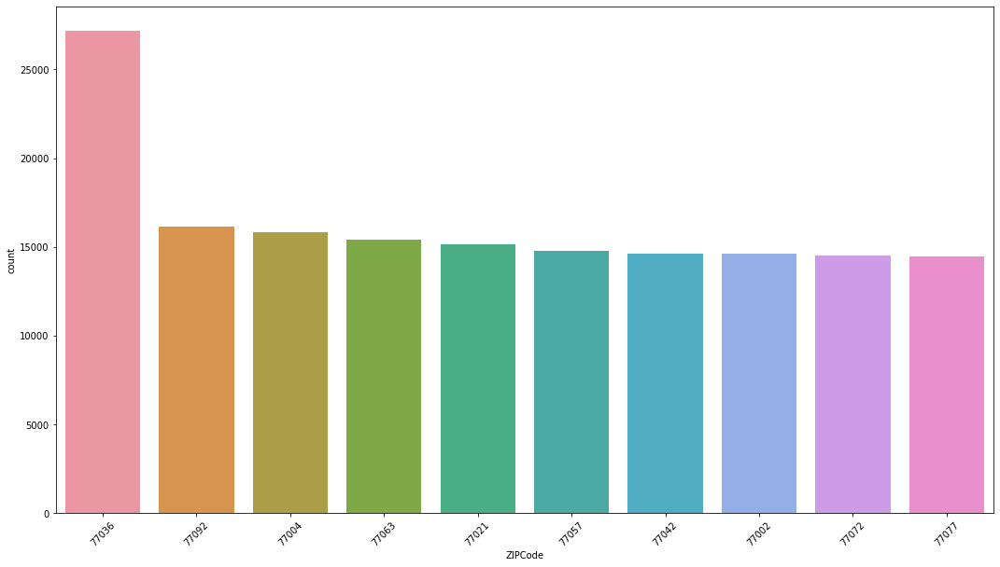

In [ ]:
# Select top 10 streets with the highest crime count
zip_count_top10 = zipcode_count_sdf.limit(10).toPandas()

# Create a bar plot of the top 10 Zipcode with the highest crime count
plt.figure(figsize=(18,10))
sns.barplot(x = "ZIPCode",y="count",data=zip_count_top10)
plt.ylim(0)
plt.xticks(rotation=45)
plt.show()

**Findings:**
> The frequency of crimes on WESTHEIMER Street and within the Zip code 77036 is significantly higher than that on other blocks.





#### 3.4.4 Top 10 homicide Crime count by street and zip code


---



*Homicide Offenses*

**09A** Murder & Nonnegligent Manslaughter Person

**09B** Negligent Manslaughter Person

**09C** Justifiable Homicide Person/Not a Crime

In [ ]:
# Filter rows where the Class column starts with '09'
c09_crm_sdf = hou_crm_sdf.filter(hou_crm_sdf.Class.startswith('09'))

# Get the number of rows and columns in the resulting DataFrame
num_rows = c09_crm_sdf.count()
num_cols = len(c09_crm_sdf.columns)

# Print the number of rows and columns
print("Number of rows where the Class column starts with '09':", num_rows)
print("Number of columns:", num_cols)

Number of rows where the Class column starts with '09': 1097
Number of columns: 19


In [ ]:
c09_crm_sdf.show(5)

+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+----------------+------------------+------------------+----+-----+---+---------+----------+
|             Address| Incident|Hour|Class|    NIBRSDescription|OffenseCount| Beat|             Premise|Block|   City|ZIPCode|          Street|          Latitude|         Longitude|year|month|day|dayofweek|      Date|
+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+----------------+------------------+------------------+----+-----+---+---------+----------+
|BROADWAY ST,HOUST...| 11219221|  21|  09A|Murder, non-negli...|           1|13D20| Parking Lot, Garage| 8405|HOUSTON|  77061|     BROADWAY ST|   29.659912109375| -95.2768783569336|2021|    1| 24|        1|2021-01-24|
|WENDA ST,HOUSTON,...| 82652521|  20|  09A|Murder, non-negli...|           1|14D20|Residence, Home (...| 4700|HOUSTON|  77033|  

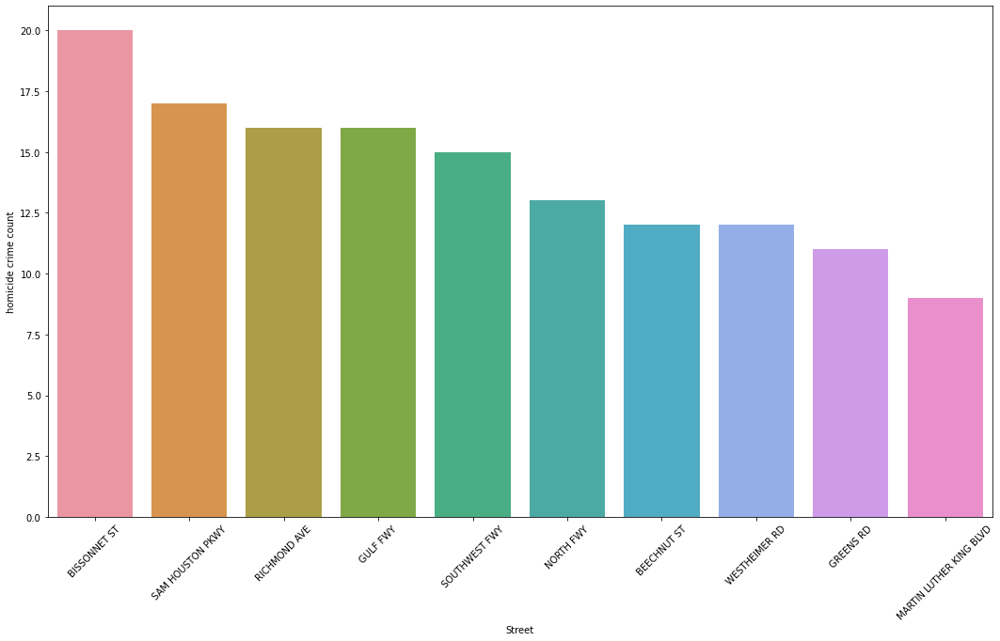

In [ ]:
# Group by StreetName, count the number of occurrences, and sort in descending order
c09_street_count = c09_crm_sdf.filter(c09_crm_sdf.Class.startswith('09')) \
                               .groupBy("Street") \
                               .count() \
                               .sort(desc("count")) \
                               .withColumnRenamed("count", "homicide crime count")

# Convert the PySpark DataFrame to a pandas DataFrame
c09_street_count = c09_street_count.toPandas()

# Create a bar plot of the top 10 street names with the highest homicide crime count
plt.figure(figsize=(18,10))
sns.barplot(x="Street", y="homicide crime count", data=c09_street_count.head(10))
plt.ylim(0)
plt.xticks(rotation=45)
plt.show()

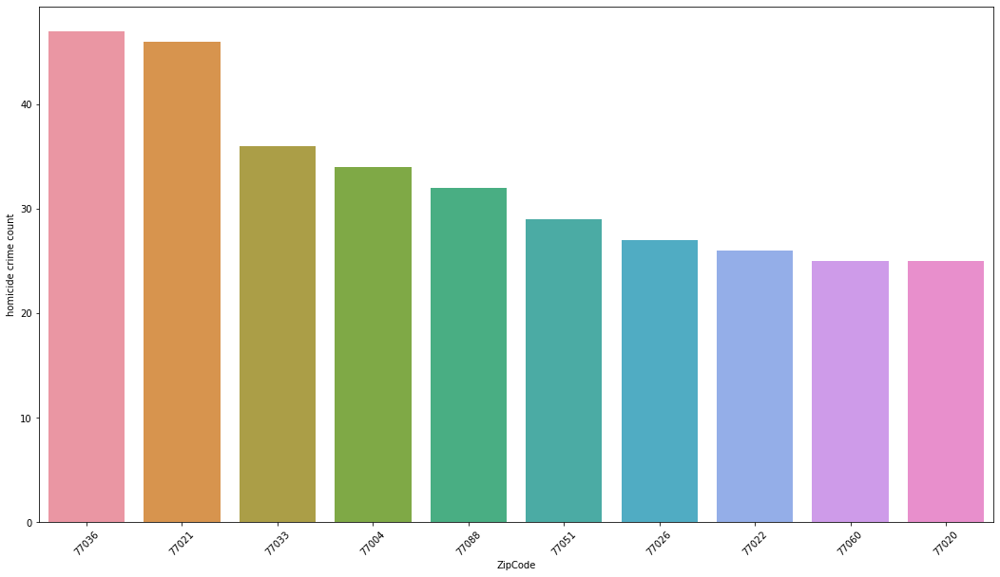

In [ ]:
# Group by StreetName, count the number of occurrences, and sort in descending order
c09_zip_count = c09_crm_sdf.filter(c09_crm_sdf.Class.startswith('09')) \
                               .groupBy("ZipCode") \
                               .count() \
                               .sort(desc("count")) \
                               .withColumnRenamed("count", "homicide crime count")

# Convert the PySpark DataFrame to a pandas DataFrame
c09_zip_count = c09_zip_count.toPandas()

# Create a bar plot of the top 10 street names with the highest homicide crime count
plt.figure(figsize=(18,10))
sns.barplot(x="ZipCode", y="homicide crime count", data=c09_zip_count.head(10))
plt.ylim(0)
plt.xticks(rotation=45)
plt.show()

In [ ]:
c09_zip_count.head(10)

,ZipCode,homicide crime count
0,77036,47
1,77021,46
2,77033,36
3,77004,34
4,77088,32
5,77051,29
6,77026,27
7,77022,26
8,77060,25
9,77020,25


**Findings:**
> Unlike the overall crime statistics, there are not many homicides on Washington Street.

> Furthermore, the number of homicides on Zip 77036 does not appear to be significantly higher compared to other blocks

---



####3.4.5 Crimes count by time


In [ ]:
from pyspark.sql.functions import count, hour, dayofweek, month, year

# Count the number of crimes by year
crime_by_year = hou_crm_sdf.groupBy("year").agg(count("*").alias("count")).orderBy("year")

# Count the number of crimes by month
crime_by_month = hou_crm_sdf.groupBy("month").agg(count("*").alias("count")).orderBy("month")

# Count the number of crimes by day of the week
crime_by_dayofweek = hou_crm_sdf.groupBy("dayofweek").agg(count("*").alias("count")).orderBy("dayofweek")

# Count the number of crimes by hour
crime_by_hour = hou_crm_sdf.groupBy("hour").agg(count("*").alias("count")).orderBy("hour")

# Display the results
crime_by_year.show()
crime_by_month.show()
crime_by_dayofweek.show()
crime_by_hour.show()

+----+------+
|year| count|
+----+------+
|2019|216313|
|2020|245138|
|2021|244133|
+----+------+

+-----+-----+
|month|count|
+-----+-----+
|    1|58799|
|    2|53275|
|    3|57510|
|    4|56341|
|    5|62359|
|    6|59525|
|    7|59855|
|    8|60967|
|    9|58177|
|   10|61227|
|   11|57920|
|   12|59629|
+-----+-----+

+---------+------+
|dayofweek| count|
+---------+------+
|        1| 98144|
|        2|101262|
|        3| 99493|
|        4|100538|
|        5| 99799|
|        6|105408|
|        7|100940|
+---------+------+

+----+-----+
|hour|count|
+----+-----+
|   0|35227|
|   1|25275|
|  10|27836|
|  11|28009|
|  12|43275|
|  13|30361|
|  14|32957|
|  15|36241|
|  16|36152|
|  17|39612|
|  18|41538|
|  19|38662|
|   2|22831|
|  20|38380|
|  21|36690|
|  22|36423|
|  23|32460|
|   3|17609|
|   4|13541|
|   5|11788|
+----+-----+
only showing top 20 rows



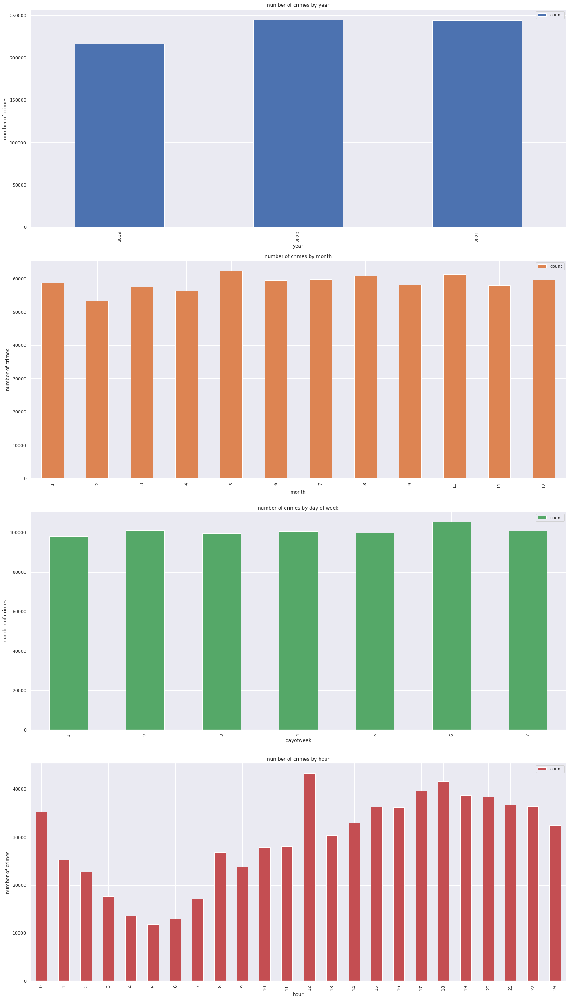

In [ ]:
fig,(ax1,ax2,ax3,ax4)=plt.subplots(4,1,figsize=(20,35))

sns.set() 

hou_crm_sdf.groupBy("year") \
           .count() \
           .orderBy("year") \
           .toPandas() \
           .plot(kind="bar", x="year", y="count", ax=ax1, color="C0")
ax1.set_ylabel("number of crimes")
ax1.set_title("number of crimes by year")

hou_crm_sdf.groupBy("month") \
           .count() \
           .orderBy("month") \
           .toPandas() \
           .plot(kind="bar", x="month", y="count", ax=ax2, color="C1")
ax2.set_ylabel("number of crimes")
ax2.set_title("number of crimes by month")

hou_crm_sdf.groupBy("dayofweek") \
           .count() \
           .orderBy("dayofweek") \
           .toPandas() \
           .plot(kind="bar", x="dayofweek", y="count", ax=ax3, color="C2")
ax3.set_ylabel("number of crimes")
ax3.set_title("number of crimes by day of week")

hou_crm_sdf.groupBy("hour") \
           .count() \
           .orderBy(col("hour").cast("int")) \
           .toPandas() \
           .plot(kind="bar", x="hour", y="count", ax=ax4, color="C3")
ax4.set_ylabel("number of crimes")
ax4.set_title("number of crimes by hour")

plt.tight_layout()
plt.show()



**Findings:**
> The countplot reveals that there is an increase in the number of crimes from 2019 to 2020, but the figures for 2020 and 2021 are comparable. Further analysis will be conducted through a series of category-time charts.


> Crime rates do not vary significantly across different months and days of the week.

> The lowest crime rates are observed between 3-7 a.m. and steadily rise throughout the day. The peak occurs around 6 p.m. and then gradually declines. Additionally, there are two smaller peaks at 12 a.m. and 12 p.m. during the midnight and lunch hour, respectively. Overall, crime rates show a distinct pattern over the course of a day.








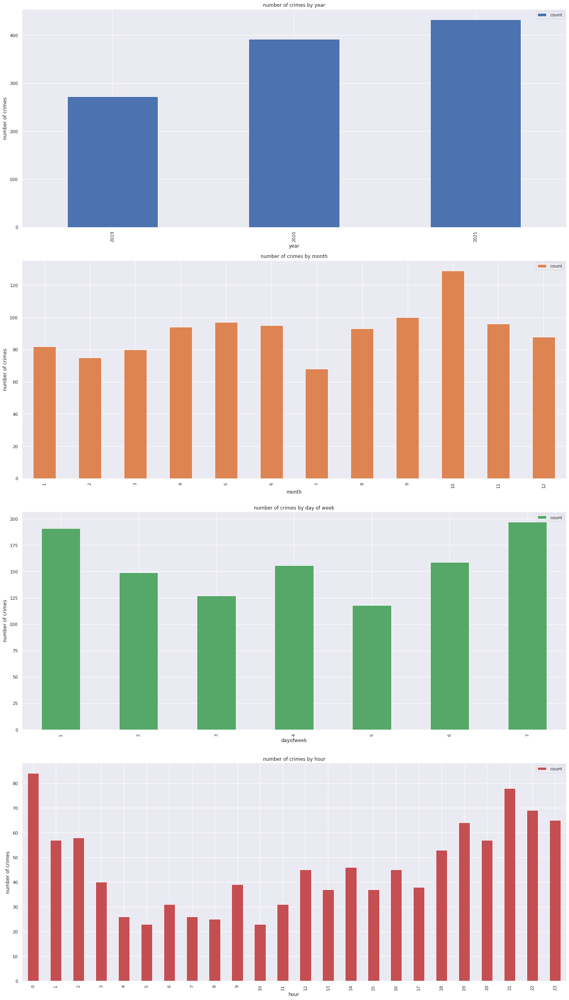

In [ ]:
fig,(ax1,ax2,ax3,ax4)=plt.subplots(4,1,figsize=(20,35))

sns.set() 

c09_crm_sdf.groupBy("year") \
           .count() \
           .orderBy("year") \
           .toPandas() \
           .plot(kind="bar", x="year", y="count", ax=ax1, color="C0")
ax1.set_ylabel("number of crimes")
ax1.set_title("number of crimes by year")

c09_crm_sdf.groupBy("month") \
           .count() \
           .orderBy("month") \
           .toPandas() \
           .plot(kind="bar", x="month", y="count", ax=ax2, color="C1")
ax2.set_ylabel("number of crimes")
ax2.set_title("number of crimes by month")

c09_crm_sdf.groupBy("dayofweek") \
           .count() \
           .orderBy("dayofweek") \
           .toPandas() \
           .plot(kind="bar", x="dayofweek", y="count", ax=ax3, color="C2")
ax3.set_ylabel("number of crimes")
ax3.set_title("number of crimes by day of week")

c09_crm_sdf.groupBy("hour") \
           .count() \
           .orderBy(col("hour").cast("int")) \
           .toPandas() \
           .plot(kind="bar", x="hour", y="count", ax=ax4, color="C3")
ax4.set_ylabel("number of crimes")
ax4.set_title("number of crimes by hour")

plt.tight_layout()
plt.show()

**Findings:**
> Unlike all crimes trend, the number of homicide crime has a clear upward trend from 2019 to 2021. This is consistent with the national homicide rate in the United States, as provisional data from the CDC's National Center for Health Statistics indicate a 30% increase in the homicide rate between 2019 and 2020.

> There is a significant increase in the number of homicide crimes in October compared to other months, with a small peak around Halloween, as evident in the next qc. Another interesting statistic is that Mexico reported a record-high homicide rate in October 2022

> The occurrence of homicides is more frequent on weekends than weekdays, which supports the idea that interpersonal interactions outside of the workplace may lead to higher rates of aggressive crime.

> In terms of time of day, homicides are most likely to occur during the night, with the period between midnight and 1:00 a.m. being the deadliest.




**Number of all crimes per month**


---



In [ ]:
hou_crm_sdf.show(5)

+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------+------------------+------------------+----+-----+---+---------+----------+
|             Address| Incident|Hour|Class|    NIBRSDescription|OffenseCount| Beat|             Premise|Block|   City|ZIPCode|        Street|          Latitude|         Longitude|year|month|day|dayofweek|      Date|
+--------------------+---------+----+-----+--------------------+------------+-----+--------------------+-----+-------+-------+--------------+------------------+------------------+----+-----+---+---------+----------+
|HUTTON,HOUSTON,77026|  6439121|  20|  13B|      Simple assault|           1| 7C20|Residence, Home (...| 2123|HOUSTON|  77026|        HUTTON|29.782869338989258|-95.33181762695312|2021|    1| 14|        5|2021-01-14|
|BERRY RD,HOUSTON,...| 69918620|  22|  240| Motor vehicle theft|           1| 7C30|Residence, Home (...| 2600|HOUSTON|  77093|      BERR

In [ ]:

hou_crm_df = hou_crm_sdf.toPandas()
hou_crm_df.index = pd.DatetimeIndex(hou_crm_df.Date)


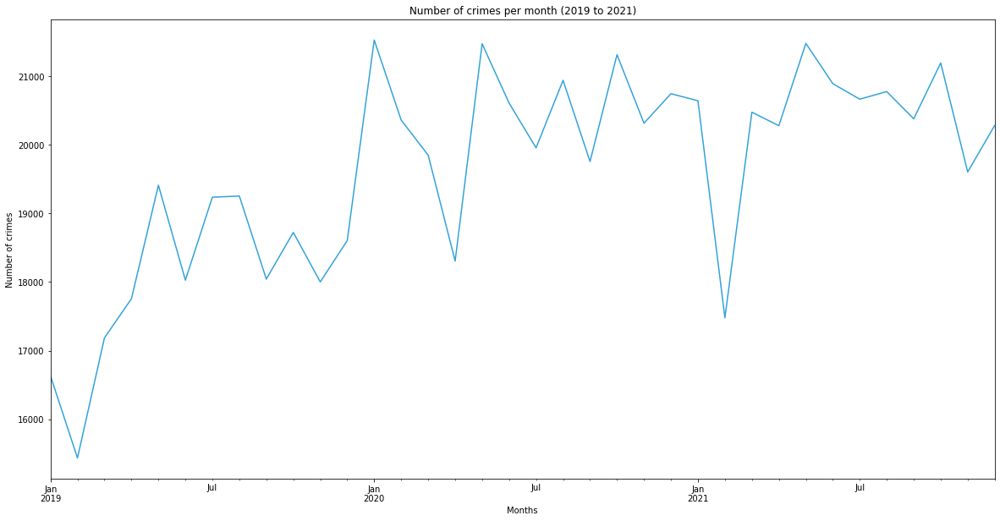

In [ ]:
plt.figure(figsize=(20,10))
hou_crm_df.resample('M').size().plot(legend=False)
plt.title('Number of crimes per month (2019 to 2021)')
plt.xlabel('Months')
plt.ylabel('Number of crimes')
plt.show()

**Rolling sum of all crimes from 2019 to 2021**


---


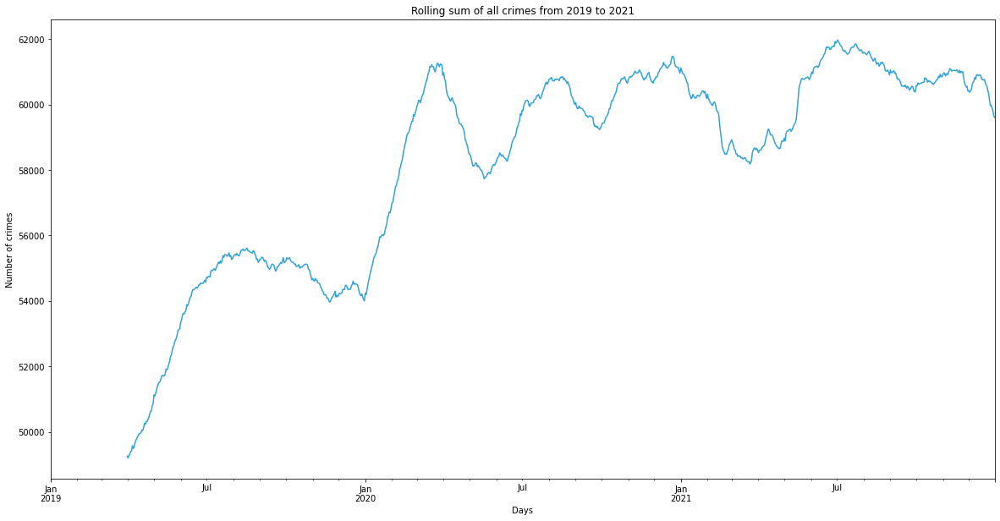

In [ ]:
plt.figure(figsize=(20,10))
hou_crm_df.resample('D').size().rolling(90).sum().plot()
plt.title('Rolling sum of all crimes from 2019 to 2021')
plt.ylabel('Number of crimes')
plt.xlabel('Days')
plt.show()

**Rolling sum of homicide crimes from 2019 to 2021**


---


In [ ]:
c09_crm_df = hou_crm_df[hou_crm_df.Class.str.startswith('09')]
c09_crm_df.shape

(1097, 19)

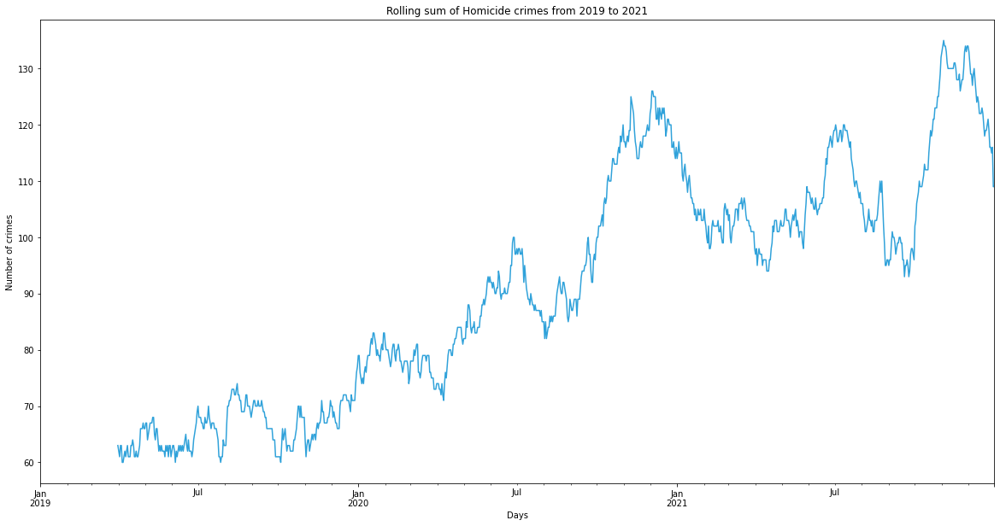

In [ ]:
c09_crm_df.index = pd.DatetimeIndex(c09_crm_df.Date)
plt.figure(figsize=(20,10))
c09_crm_df.resample('D').size().rolling(90).sum().plot()
plt.title('Rolling sum of Homicide crimes from 2019 to 2021')
plt.ylabel('Number of crimes')
plt.xlabel('Days')
plt.show()

**Findings: **
> This graph shows two peaks near the end of October 2020 and 2021, as expected.




**Rolling sum of different kinds of crimes from 2019 to 2021**

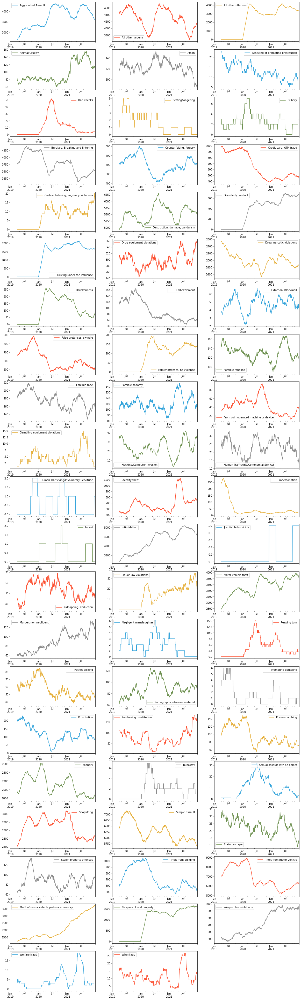

In [ ]:
crimes_count_date = hou_crm_df.pivot_table('Incident', aggfunc=np.size, columns='NIBRSDescription', index=hou_crm_df.index.date, fill_value=0)
crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
plo = crimes_count_date.rolling(90).sum().plot(figsize=(20, 70), subplots=True, layout=(-1, 3), sharex=False, sharey=False)

**Findings:**
> The availability of plots for each type of crime is a valuable asset to our social security research. A thorough analysis of the data reveals several noteworthy trends, including a decline in the incidence of credit card fraud, embezzlement, theft from motor vehicles, and simple assault. Consequently, there has been an overall reduction in the number of reported crimes between 2020 and 2021. The underlying causes of this shift are complex, but it is possible that they are linked to technological advancements and the impact of the Covid-19 pandemic.

> Other types of crimes, including murder and violations of weapon laws, are increasing. This raises the question of whether we should support the idea of carrying firearms.

###3.5.Time distribution of shooting

Text(0.5, 1.0, 'number of crimes by hour')

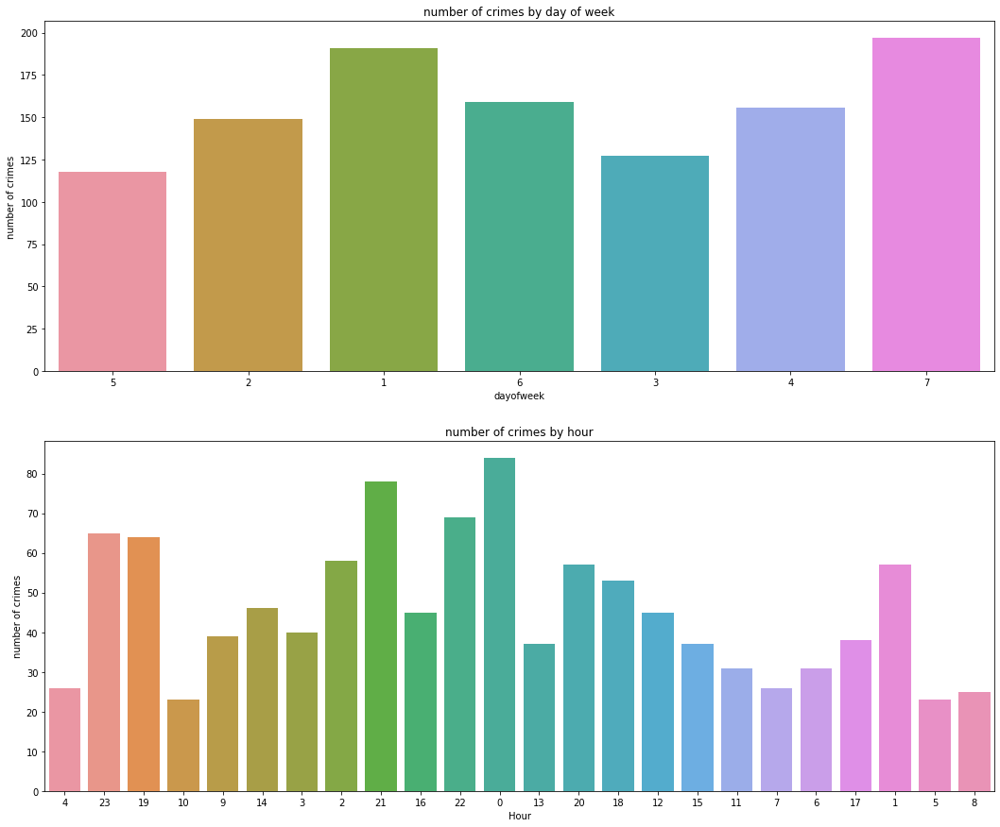

In [ ]:
fig,(ax1,ax2)=plt.subplots(2,1,figsize=(18,15))


sns.countplot(x="dayofweek",data=c09_crm_df,ax=ax1)
ax1.set_ylabel("number of crimes")
ax1.set_title("number of crimes by day of week")

sns.countplot(x="Hour",data=c09_crm_df,ax=ax2)
ax2.set_ylabel("number of crimes")
ax2.set_title("number of crimes by hour")

**Findings:**
>Saturday and Sunday exhibit a substantially higher rate of homicides compared to the other days of the week. Additionally, the majority of homicides took place during late hours, specifically between 7pm and 12am.

###3.6.Geospatial Visualization

####3.6.1 Distributin Map

In [ ]:
hou_crm_df.shape

(705584, 19)

In [ ]:
hou_crm_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 705584 entries, 2021-01-14 to 2019-10-12
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Address           705584 non-null  object
 1   Incident          705584 non-null  object
 2   Hour              705584 non-null  object
 3   Class             705584 non-null  object
 4   NIBRSDescription  705584 non-null  object
 5   OffenseCount      705584 non-null  object
 6   Beat              705530 non-null  object
 7   Premise           705583 non-null  object
 8   Block             704008 non-null  object
 9   City              705584 non-null  object
 10  ZIPCode           705584 non-null  int64 
 11  Street            705584 non-null  object
 12  Latitude          705584 non-null  object
 13  Longitude         705584 non-null  object
 14  year              705584 non-null  object
 15  month             705584 non-null  object
 16  day               7055

In [ ]:
Zipcode_count=pd.DataFrame(hou_crm_df.groupby("ZIPCode").size().sort_values(ascending=False).rename("counts").reset_index())
Zipcode_count["ZIPCode"]=Zipcode_count["ZIPCode"].astype(int)
Zipcode_count.shape

(190, 2)

In [ ]:
hou_crm_df["ZIPCode"]=hou_crm_df["ZIPCode"].astype(int)
hou_crm_df["Latitude"]=hou_crm_df["Latitude"].astype(float)
hou_crm_df["Longitude"]=hou_crm_df["Longitude"].astype(float)
hou_crm_df2 = hou_crm_df
hou_crm_df2 = hou_crm_df2.merge(Zipcode_count, how ='left', on="ZIPCode")
hou_crm_df2.shape


(705584, 20)

/usr/local/lib/python3.8/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=4104363.7730461885,257726.53930087126,4235145.09866043,382750.68097630027&bboxSR=2770&imageSR=2770&size=1500,1433&dpi=96&format=png32&transparent=true&f=image


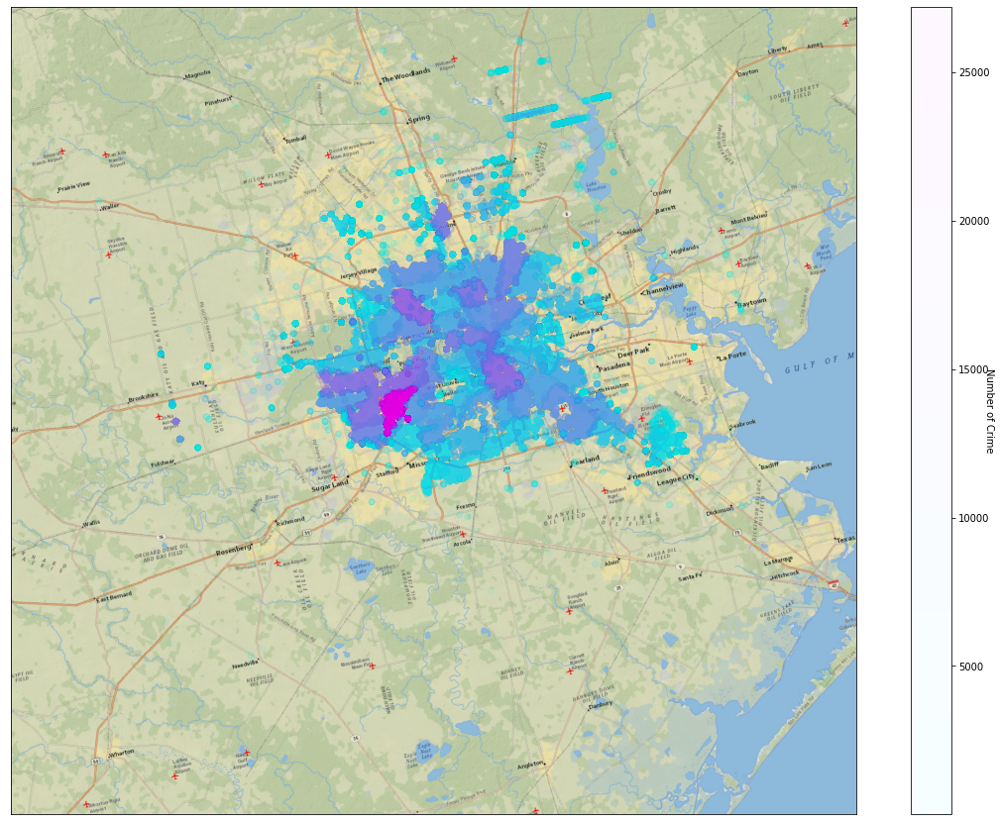

In [ ]:
from mpl_toolkits.basemap import Basemap

m = Basemap(projection='mill',llcrnrlat=hou_crm_df.Latitude.min()+0.4,urcrnrlat=hou_crm_df.Latitude.max()-0.4,
            llcrnrlon=hou_crm_df.Longitude.min(),urcrnrlon=hou_crm_df.Longitude.max(),resolution="c",epsg=2770)
x,y= m(tuple(hou_crm_df2.Longitude[(hou_crm_df2.Longitude.isnull()==False)]),tuple(hou_crm_df2.Latitude[(hou_crm_df2.Latitude.isnull()==False)]))

color = hou_crm_df2.counts[(hou_crm_df2.Longitude.isnull()==False)]
size = color.div(100).add(10)

plt.figure(figsize=(20,15))
m.arcgisimage(service="NatGeo_World_Map",xpixels=1500,verbose=True)
sc = m.scatter(x,y, c=color, cmap ='cool', alpha=0.03)
cbar = plt.colorbar(sc)
cbar.set_label("Number of Crime", rotation=270)
#cbar.set_clim(color.min(), color.max())
plt.show()


**Comments:**
> All cases are marked on the map according to their geographical location. The color map shows the crime count per zip code, providing clear visual cues about how crime is distributed across different areas.

> Hot colors on the map represent high crime rates per zip code, while cool colors suggest low crime rates. The plum triangle shape on the map represents Zip code 77036, which is considered the most dangerous neighborhood in Houston.

> The map emphasizes the areas with high crime rates, allowing for a more focused analysis of the specific neighborhoods or regions where crimes are more likely to occur.

In [ ]:
c09_crm_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1097 entries, 2020-12-10 to 2020-01-31
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Address           1097 non-null   object 
 1   Incident          1097 non-null   object 
 2   Hour              1097 non-null   object 
 3   Class             1097 non-null   object 
 4   NIBRSDescription  1097 non-null   object 
 5   OffenseCount      1097 non-null   object 
 6   Beat              1097 non-null   object 
 7   Premise           1097 non-null   object 
 8   Block             1097 non-null   object 
 9   City              1097 non-null   object 
 10  ZIPCode           1097 non-null   int64  
 11  Street            1097 non-null   object 
 12  Latitude          1097 non-null   float64
 13  Longitude         1097 non-null   float64
 14  year              1097 non-null   object 
 15  month             1097 non-null   object 
 16  day               1097 n

In [ ]:
c09_Zipcode_count=pd.DataFrame(c09_crm_df.groupby("ZIPCode").size().sort_values(ascending=False).rename("counts").reset_index())
c09_Zipcode_count["ZIPCode"]=c09_Zipcode_count["ZIPCode"].astype(int)
c09_Zipcode_count.shape

(94, 2)

In [ ]:

c09_crm_df.loc[:, "ZIPCode"] = c09_crm_df["ZIPCode"].astype(int)
c09_crm_df.loc[:, "Latitude"] = c09_crm_df["Latitude"].astype(float)
c09_crm_df.loc[:, "Longitude"]=c09_crm_df["Longitude"].astype(float)
c09_crm_df2 = c09_crm_df.merge(c09_Zipcode_count, how ='left', on="ZIPCode")
c09_crm_df2.head(1)

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


,Address,Incident,Hour,Class,NIBRSDescription,OffenseCount,Beat,Premise,Block,City,ZIPCode,Street,Latitude,Longitude,year,month,day,dayofweek,Date,counts
0,"SANDROCK DR,HOUSTON,77048",164002620,4,09A,"Murder, non-negligent",1,14D40,"Highway, Road, Street, Alley",11800,HOUSTON,77048,SANDROCK DR,29.632862,-95.343445,2020,12,10,5,2020-12-10,13


/usr/local/lib/python3.7/dist-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


http://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/export?bbox=4104363.7730461885,257726.53930087126,4235145.09866043,382750.68097630027&bboxSR=2770&imageSR=2770&size=1500,1433&dpi=96&format=png32&transparent=true&f=image


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: MatplotlibDeprecationWarning: 
The set_clim function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use ScalarMappable.set_clim instead.
  


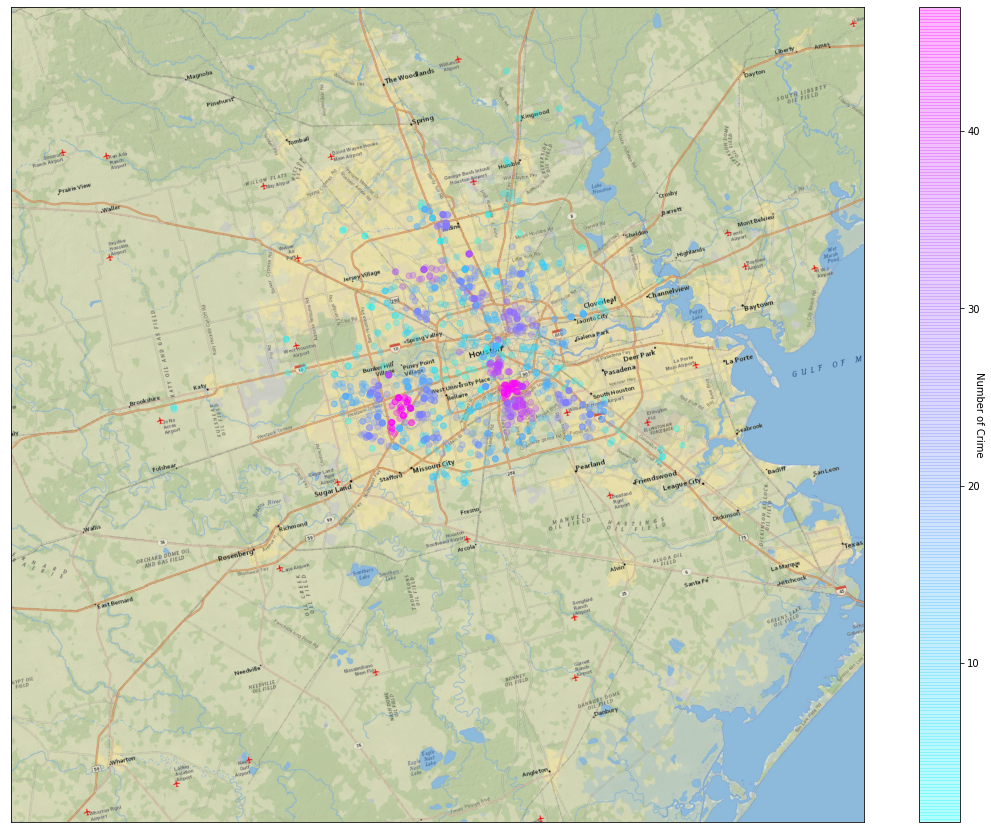

In [ ]:
m = Basemap(projection='mill',llcrnrlat=hou_crm_df.Latitude.min()+0.4,urcrnrlat=hou_crm_df.Latitude.max()-0.4,
            llcrnrlon=hou_crm_df.Longitude.min(),urcrnrlon=hou_crm_df.Longitude.max(),resolution="c",epsg=2770)
x,y= m(tuple(c09_crm_df2.Longitude[(c09_crm_df2.Longitude.isnull()==False)]),tuple(c09_crm_df2.Latitude[(c09_crm_df2.Latitude.isnull()==False)]))

color = c09_crm_df2.counts[(c09_crm_df2.Longitude.isnull()==False)]
size = color.div(2).add(10)


plt.figure(figsize=(20,15))
m.arcgisimage(service="NatGeo_World_Map",xpixels=1500,verbose=True)
sc = m.scatter(x,y, c=color, cmap ='cool', alpha=0.3)
cbar = plt.colorbar(sc)
cbar.set_label("Number of Crime", rotation=270)
cbar.set_clim(color.min(), color.max())
plt.show()

**Comments:**
> All homicide cases are marked on the map according to their geographical location. 

> Additionally, the map highlights two specific areas represented in plum color, which correspond to the Zipcodes 77036 and 77021. These areas are described as "deadly neighborhoods" in Houston, suggesting that they have a higher concentration of homicides compared to other areas in the city.


####3.6.2 Heat Map


In [ ]:
import folium
from folium import plugins
from folium.plugins import HeatMap

## All crimes Heat Map
map_heat= folium.Map(location=[29.7604, -95.3698],zoom_start = 10) 
crm_data= hou_crm_df2.dropna(axis = 0, subset = ['Latitude'] )
heat_data = [[row['Latitude'],row['Longitude']] for index, row in crm_data.iterrows()]
HeatMap(heat_data,radius=16).add_to(map_heat)
map_heat

**Comments:**
> The heat map qc count crimes per coordinate. This is different from the previous map qc, which counts crime per zipcode. 

> This heat map shows the magnitude of crime rate as color in two dimensions. The variation in color is giving obvious visual cues about how the crime is clustered or varies over space.

> The downtown and uptown areas are highlighted in bright red, indicating the highest crime intensity.





In [ ]:
## Murder Heat Map
map_heat= folium.Map(location=[29.7604, -95.3698],zoom_start = 10) 
shoot_data=c09_crm_df2.dropna(axis = 0, subset = ['Latitude'] )
heat_data = [[row['Latitude'],row['Longitude']] for index, row in shoot_data.iterrows()]
HeatMap(heat_data,radius=16).add_to(map_heat)
map_heat

**Comments:**

> The areas in bright red near downtown Houston exhibit the highest concentration of homicide crimes.

####3.6.3 Heat Map with Time

In [ ]:
# Click the third blank boxes in the bottom left corner of the map to play.
map_heat = folium.Map(location=[29.7604, -95.3698],zoom_start = 10) 
heat_df = shoot_data
heat_df['Weight'] = shoot_data['month']
heat_df['Weight'] = heat_df['Weight'].astype(float)
heat_df = heat_df.dropna(axis=0, subset=['Latitude','Longitude', 'month'])
heat_data = [[[row['Latitude'],row['Longitude']] for index, row in heat_df[heat_df['month'] == i].iterrows()] for i in range(1,13)]

hm = plugins.HeatMapWithTime(heat_data,radius=25,auto_play=False,max_opacity=0.5)
hm.add_to(map_heat)
map_heat

**comment**

> The crime heat map variation in different months is represented by the Heatmaptime QC.

In [ ]:
# save and backup the dataframe
save_gdrive(hou_crm_sdf,"hou_crm_sdf_step5",5)

hou_crm_sdf_cp5 = hou_crm_sdf

number of rows per file : 141116
file0 start at : 0
file0 end at : 141116
file1 start at : 141116
file1 end at : 282232
file2 start at : 282232
file2 end at : 423348
file3 start at : 423348
file3 end at : 564464
file4 start at : 564464
file4 end at : 705580
file5 start at : 705580
file5 end at : 846696


In [ ]:
### read the spark dataframe step 5
from pyspark.sql import SparkSession


link = 'https://drive.google.com/drive/folders/1dZvuD9mhHtrA4ReUOR2QXt9aqThc0XpY'

listed = drive.ListFile({'q': "'1dZvuD9mhHtrA4ReUOR2QXt9aqThc0XpY' in parents"}).GetList()
list_id = []
list_title = []

for file in listed:
  if 'sdf_step5' in file['title']:
    list_id.append(file['id'])
    list_title.append(file['title'])
    print(file['title'])

# Download the CSV files to the local file system
for file_id in list_id:
    file = drive.CreateFile({'id': file_id})
    file.GetContentFile(file['title'])

# Read each CSV file into a Spark DataFrame
hou_crm_sdf = spark.read.option("header", "true").csv(list_title)


# Drop duplicates
hou_crm_sdf = hou_crm_sdf.dropDuplicates()

# Print schema
hou_crm_sdf.printSchema()

# Show the first 5 rows
hou_crm_sdf.show(5)

hou_crm_sdf_step5_p5.csv
hou_crm_sdf_step5_p4.csv
hou_crm_sdf_step5_p3.csv
hou_crm_sdf_step5_p2.csv
hou_crm_sdf_step5_p1.csv
hou_crm_sdf_step5_p0.csv
root
 |-- _c0: string (nullable = true)
 |-- Address: string (nullable = true)
 |-- Incident: string (nullable = true)
 |-- Hour: string (nullable = true)
 |-- Class: string (nullable = true)
 |-- NIBRSDescription: string (nullable = true)
 |-- OffenseCount: string (nullable = true)
 |-- Beat: string (nullable = true)
 |-- Premise: string (nullable = true)
 |-- Block: string (nullable = true)
 |-- City: string (nullable = true)
 |-- ZIPCode: string (nullable = true)
 |-- Street: string (nullable = true)
 |-- Latitude: string (nullable = true)
 |-- Longitude: string (nullable = true)
 |-- year: string (nullable = true)
 |-- month: string (nullable = true)
 |-- day: string (nullable = true)
 |-- dayofweek: string (nullable = true)
 |-- Date: string (nullable = true)

+------+--------------------+---------+----+-----+--------------------+---

In [ ]:
hou_crm_sdf.schema

StructType([StructField('_c0', StringType(), True), StructField('Address', StringType(), True), StructField('Incident', StringType(), True), StructField('Hour', StringType(), True), StructField('Class', StringType(), True), StructField('NIBRSDescription', StringType(), True), StructField('OffenseCount', StringType(), True), StructField('Beat', StringType(), True), StructField('Premise', StringType(), True), StructField('Block', StringType(), True), StructField('City', StringType(), True), StructField('ZIPCode', StringType(), True), StructField('Street', StringType(), True), StructField('Latitude', StringType(), True), StructField('Longitude', StringType(), True), StructField('year', StringType(), True), StructField('month', StringType(), True), StructField('day', StringType(), True), StructField('dayofweek', StringType(), True), StructField('Date', StringType(), True)])

In [ ]:
hou_crm_sdf = hou_crm_sdf.drop('_c0')
print((hou_crm_sdf.count(), len(hou_crm_sdf.columns)))

(705584, 19)


In [ ]:
hou_crm_sdf.describe().show()

+-------+--------------------+--------------------+------------------+------------------+------------------+------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+-------------------+------------------+-----------------+------------------+------------------+----------+
|summary|             Address|            Incident|              Hour|             Class|  NIBRSDescription|      OffenseCount|                Beat|             Premise|            Block|     City|          ZIPCode|              Street|           Latitude|          Longitude|              year|            month|               day|         dayofweek|      Date|
+-------+--------------------+--------------------+------------------+------------------+------------------+------------------+--------------------+--------------------+-----------------+---------+-----------------+--------------------+-------------------+------------------

##4.Model


### 4.1.Kmeans 

In [ ]:
# Import PySpark functions
import pyspark.sql.functions as F

# Define a list of columns to be cast
cols_to_cast_f = [ "Latitude", "Longitude"]
cols_to_cast_i = ["ZIPCode", "year", "month","hour","dayofweek","day"]

# Cast the columns to the desired data types
for col in cols_to_cast_f:
    hou_crm_sdf = hou_crm_sdf.withColumn(col, F.col(col).cast("float"))

for col in cols_to_cast_i:
    hou_crm_sdf = hou_crm_sdf.withColumn(col, F.col(col).cast("int"))  

# QC
hou_crm_sdf.schema


StructType([StructField('Address', StringType(), True), StructField('Incident', StringType(), True), StructField('hour', IntegerType(), True), StructField('Class', StringType(), True), StructField('NIBRSDescription', StringType(), True), StructField('OffenseCount', StringType(), True), StructField('Beat', StringType(), True), StructField('Premise', StringType(), True), StructField('Block', StringType(), True), StructField('City', StringType(), True), StructField('ZIPCode', IntegerType(), True), StructField('Street', StringType(), True), StructField('Latitude', FloatType(), True), StructField('Longitude', FloatType(), True), StructField('year', IntegerType(), True), StructField('month', IntegerType(), True), StructField('day', IntegerType(), True), StructField('dayofweek', IntegerType(), True), StructField('Date', StringType(), True)])

In [ ]:
from pyspark.sql.functions import count,when,col
# Check for null values in the DataFrame
null_counts = hou_crm_sdf.select([count(when(col(c).isNull(), c)).alias(c) for c in hou_crm_sdf.columns])

# Print the null counts for each column
null_counts.show()

+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+
|Address|Incident|hour|Class|NIBRSDescription|OffenseCount|Beat|Premise|Block|City|ZIPCode|Street|Latitude|Longitude|year|month|day|dayofweek|Date|
+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+
|      0|       0|   0|    0|               0|           0|  54|      1| 1576|   0|      0|     0|       0|        0|   0|    0|  0|        0|   0|
+-------+--------+----+-----+----------------+------------+----+-------+-----+----+-------+------+--------+---------+----+-----+---+---------+----+



In [ ]:
X = hou_crm_sdf.select('Latitude', 'Longitude', 'Premise')
X = X.filter(col('Premise').isNotNull())

In [ ]:
print((X.count(), len(X.columns)))

(705583, 3)


In [ ]:
from  pyspark.ml.feature import StringIndexer

inputs = ['Premise']
outputs = ['Pindx']
stringIndexer = StringIndexer(inputCols=inputs, outputCols=outputs)
model = stringIndexer.fit(X)
X_t = model.transform(X)
X_t.show()

+---------+----------+--------------------+-----+
| Latitude| Longitude|             Premise|Pindx|
+---------+----------+--------------------+-----+
|29.726942|-95.370964|Highway, Road, St...|  2.0|
|29.678602| -95.49295|Residence, Home (...|  0.0|
|  29.7546| -95.61856|Residence, Home (...|  0.0|
|29.731655| -95.46645| Parking Lot, Garage|  1.0|
|29.681046| -95.38489| Parking Lot, Garage|  1.0|
| 29.77955| -95.34495|Highway, Road, St...|  2.0|
|29.951214| -95.35345| Parking Lot, Garage|  1.0|
|29.737389|-95.513374|    Speciality Store| 10.0|
|29.677227| -95.42786|   Convenience Store|  5.0|
|29.870104|-95.384926|          Restaurant|  7.0|
|29.569021| -95.13054| Parking Lot, Garage|  1.0|
|29.791725|-95.323006|Highway, Road, St...|  2.0|
|29.966955| -95.56089|Residence, Home (...|  0.0|
|29.889486| -95.37319|Residence, Home (...|  0.0|
|29.778921| -95.45533|Commercial, Offic...|  6.0|
| 29.54203| -95.14791| Parking Lot, Garage|  1.0|
|29.769825| -95.39969|Highway, Road, St...|  2.0|


In [ ]:
X_t = X_t.withColumn("Pindx", col("Pindx").cast("float"))

In [ ]:
from pyspark.ml.feature import VectorAssembler, StandardScaler

# Assemble features
assembler = VectorAssembler(inputCols=['Latitude', 'Longitude', 'Pindx'], outputCol='features')
X_sdf = assembler.transform(X_t)

# Standardize the features
scaler = StandardScaler(inputCol="features", outputCol="scaledFeatures",withMean=True, withStd=True)
scalerModel = scaler.fit(X_sdf)
X_sdf_scaled = scalerModel.transform(X_sdf)

# Show the statistics of the scaled data
X_sdf_scaled.head()

Row(Latitude=29.652118682861328, Longitude=-95.25133514404297, Premise='Residence, Home (Includes Apartment)', Pindx=0.0, features=DenseVector([29.6521, -95.2513, 0.0]), scaledFeatures=DenseVector([-1.1072, 1.4175, -0.6165]))

In [ ]:
print((X_sdf.count(), len(X_sdf.columns)))

(705583, 5)


In [ ]:
print((X_sdf_scaled.count(), len(X_sdf_scaled.columns)))

(705583, 6)


####4.1.1 Two Clusters

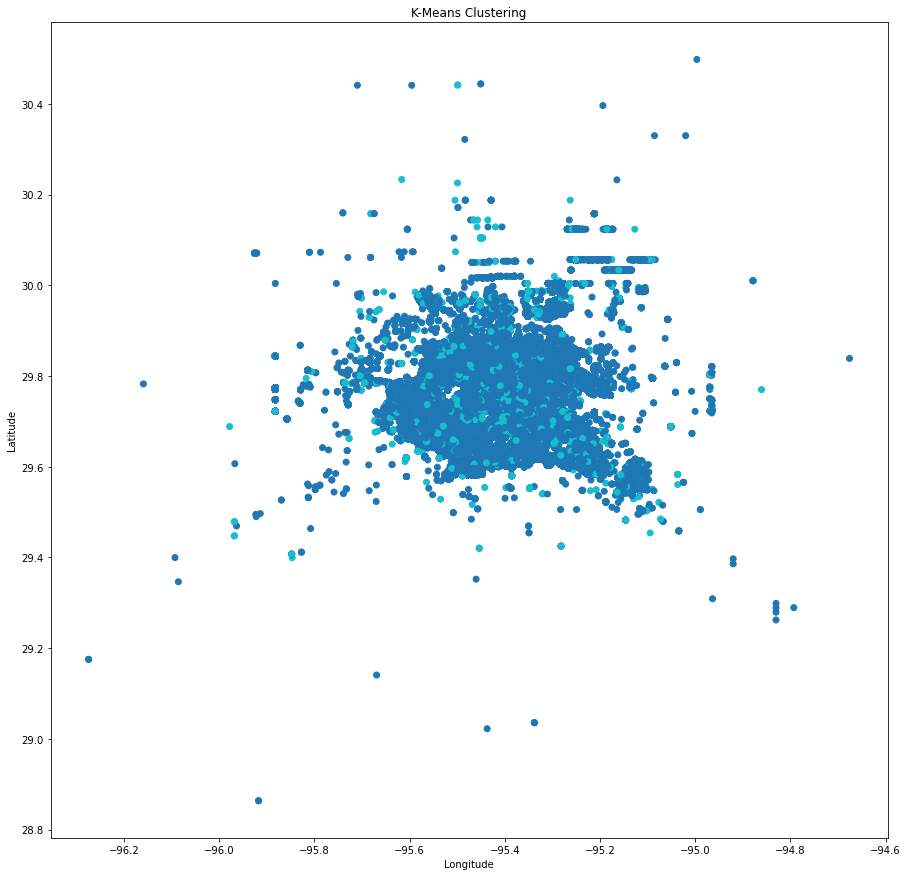

In [ ]:
from pyspark.ml.clustering import KMeans
# Run KMeans clustering
kmeans = KMeans(featuresCol='scaledFeatures', k=2, seed=1)
model0 = kmeans.fit(X_sdf_scaled)
predictions0 = model0.transform(X_sdf_scaled)

# Visualize the results
clust_labels = predictions0.select('prediction').toPandas()
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
labels = clust_labels['prediction']
ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.scatter(X_sdf.select('Longitude').toPandas(), X_sdf.select('Latitude').toPandas(), c=labels, cmap='tab10')

In [ ]:
from pyspark.ml.evaluation import ClusteringEvaluator
evaluator = ClusteringEvaluator()
silhouette = evaluator.evaluate(predictions)
sse = model.summary.trainingCost
print("Number of clusters: 2", "SSE:", sse, "Silhouette Score:", silhouette)

Number of clusters: 2 SSE: 1618902.539507827 Silhouette Score: 0.8767273764174904


**comments:**

> I ran the KMeans clustering algorithm with 2 clusters on our dataset using PySpark's pyspark.ml library. I evaluated the model using the ClusteringEvaluator, which provides the Silhouette Score for the model's clustering results. Additionally, we calculated the Sum of Squared Errors (SSE) using the 'model.summary.trainingCost' function.

> This results show that the SSE for the 2-cluster model is relatively high. The Silhouette Score for the 2-cluster model is also not very high, indicating that the clusters may not be well-separated.

> Based on these results, concluded that the 2-cluster model is suboptimal. To determine the optimum number of clusters, we decided to perform further analysis by testing additional numbers of clusters and comparing their evaluation metrics.

####4.1.2 Optimum cluster value

I will now determine the optimum number of clusters for this dataset by testing additional numbers of clusters and comparing their SSE and Silhouette Score values. Then choose the number of clusters that provides the best balance between a low SSE and a high Silhouette Score.

In [ ]:
from pyspark.ml.evaluation import ClusteringEvaluator
SSE = []
for cluster in range(2, 16):
    kmeans = KMeans(featuresCol='scaledFeatures').setK(cluster).setSeed(1)
    model = kmeans.fit(X_sdf_scaled)
    predictions = model.transform(X_sdf_scaled)
    evaluator = ClusteringEvaluator()
    silhouette = evaluator.evaluate(predictions)
    sse = model.summary.trainingCost
    print("Number of clusters:", cluster, "SSE:", sse, "Silhouette Score:", silhouette)
    SSE.append(sse)


Number of clusters: 2 SSE: 1618902.539507629 Silhouette Score: 0.8767273764174904
Number of clusters: 3 SSE: 1295741.7099464957 Silhouette Score: 0.0783302836093822
Number of clusters: 4 SSE: 895046.8314561403 Silhouette Score: 0.04028004143958762
Number of clusters: 5 SSE: 833488.6285447461 Silhouette Score: 0.03146499203676266
Number of clusters: 6 SSE: 724407.1156468326 Silhouette Score: -0.06667412436023866
Number of clusters: 7 SSE: 661933.9581333839 Silhouette Score: -0.1351910159437895
Number of clusters: 8 SSE: 588229.9278151935 Silhouette Score: -0.12338525841211913
Number of clusters: 9 SSE: 562574.4843403317 Silhouette Score: -0.1727430720852066
Number of clusters: 10 SSE: 561235.8920580936 Silhouette Score: -0.11309962750562685
Number of clusters: 11 SSE: 496788.2448853639 Silhouette Score: -0.17629459285805246
Number of clusters: 12 SSE: 466802.8724982478 Silhouette Score: -0.12902320575383808
Number of clusters: 13 SSE: 428515.4747890164 Silhouette Score: -0.1568679864815

Text(0, 0.5, 'Inertia')

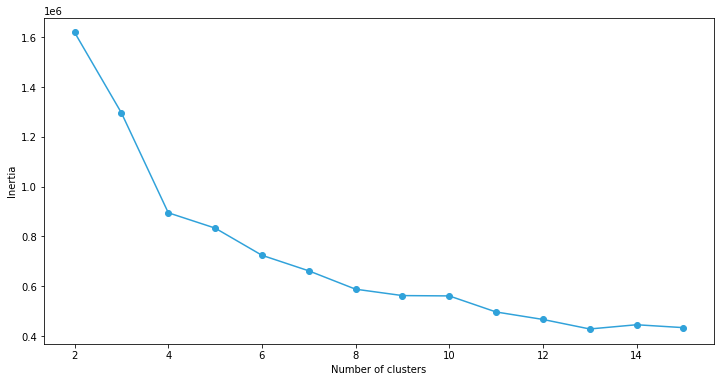

In [ ]:
# plot the results
frame = pd.DataFrame({'Cluster':range(2,16), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'], frame['SSE'], marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

> The results show that increasing the number of clusters from 2 to 3 resulted in a lower SSE, but the Silhouette Score decreased significantly. Further increasing the number of clusters led to lower Silhouette Scores and only marginal decreases in SSE. In fact, the Silhouette Scores became negative for models with 6 clusters or more, indicating that the clusters may not be well-separated and that data points within the same cluster may not be very similar to each other.

> Despite the negative Silhouette Score for the 6-cluster model, we have decided to use this model for our analysis. This decision is based on a balance between a relatively low SSE and a moderate number of clusters, which can provide us with useful insights into our dataset.


####4.1.3 Six Clusters

In [ ]:
# Run KMeans clustering
kmeans = KMeans(featuresCol='scaledFeatures', k=6, seed=1)
model = kmeans.fit(X_sdf_scaled)
predictions = model.transform(X_sdf_scaled)

In [ ]:
from pyspark.ml.evaluation import ClusteringEvaluator
evaluator = ClusteringEvaluator()
silhouette = evaluator.evaluate(predictions)
sse = model.summary.trainingCost
print("Number of clusters: 6", "SSE:", sse, "Silhouette Score:", silhouette)

Number of clusters: 6 SSE: 724407.1156468918 Silhouette Score: -0.06667412436023866


In [ ]:
print((predictions.count(), len(predictions.columns)))

(705583, 7)


In [ ]:
predictions.head()

Row(Latitude=29.72694206237793, Longitude=-95.37096405029297, Premise='Highway, Road, Street, Alley', Pindx=2.0, features=DenseVector([29.7269, -95.371, 2.0]), scaledFeatures=DenseVector([-0.294, 0.3872, -0.2276]), prediction=0)

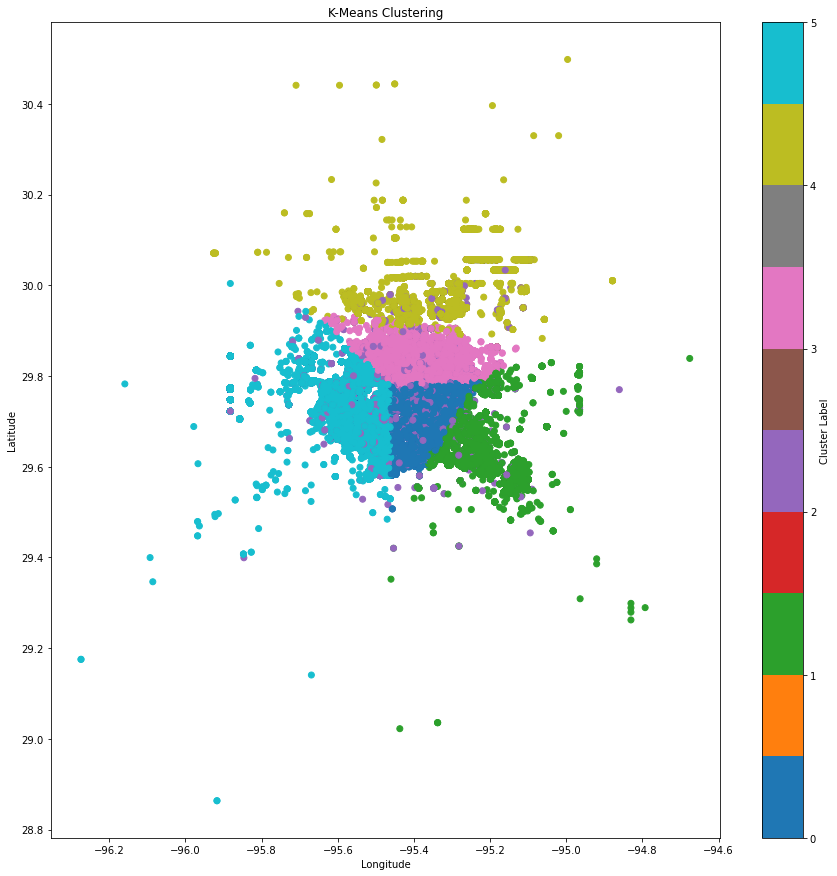

In [ ]:
# Visualize the results
clust_labels = predictions.select('prediction').toPandas()
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
labels = clust_labels['prediction']
ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.scatter(X_sdf.select('Longitude').toPandas(), X_sdf.select('Latitude').toPandas(), c=labels, cmap='tab10')
plt.colorbar(label='Cluster Label')

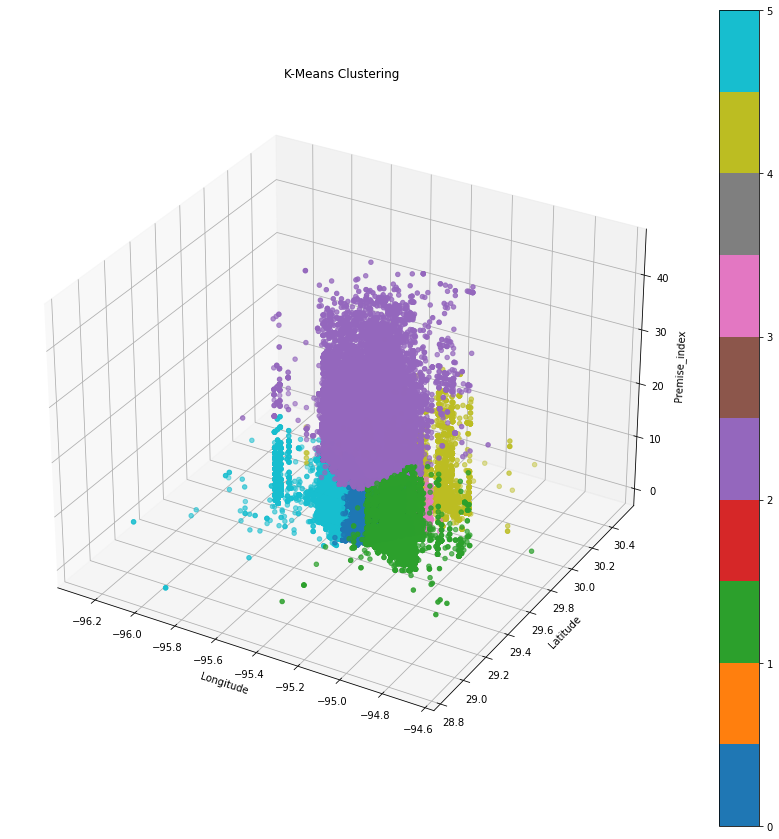

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

labels = predictions.select('prediction').rdd.flatMap(lambda x: x).collect()

ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Premise_index')

ac = ax.scatter3D(X_sdf.select('Longitude').rdd.flatMap(lambda x: x).collect(), 
                  X_sdf.select('Latitude').rdd.flatMap(lambda x: x).collect(), 
                  X_sdf.select('Pindx').rdd.flatMap(lambda x: x).collect(), 
                  c=labels, cmap='tab10')
plt.colorbar(ac,ax=ax)

**Findings:**
> The 6-cluster solution resulted in a model SSE of 724,407 and a Silhouette score of -0.067. This Silhouette score is not ideal as it is negative, indicating that some of the clusters may be overlapping. However, it is important to note that a Silhouette score of -0.067 is relatively close to zero, and as such, we believe that our model is still providing valuable insights into the data.

>When examining the cluster distribution, we found that cluster 2 covered the majority of the data with a premise index larger than 10, while the remaining five clusters separated the smaller premise index data. The distribution of clusters across the coordinate map also suggests that the clusters are representing geographically distinct regions. Specifically, cluster 1 is primarily located in the southeast corner, cluster 5 in the southwest corner, cluster 4 on the north side, cluster 0 in the central south, cluster 3 in the central north, and cluster 2 in the background covering the entire area.

In [ ]:
count_6cluster = predictions.select('Latitude', 'Longitude', 'Premise','prediction')
count_6cluster = count_6cluster.withColumnRenamed('prediction','cluster')

In [ ]:
print((count_6cluster.count(), len(count_6cluster.columns)))

(705583, 4)


In [ ]:
count_6cluster.groupby('cluster').count().orderBy('count', ascending=False).show()

+-------+------+
|cluster| count|
+-------+------+
|      5|208590|
|      0|176164|
|      3|134858|
|      1| 75609|
|      2| 64495|
|      4| 45867|
+-------+------+



In [ ]:
count_6cluster.schema

StructType([StructField('Latitude', FloatType(), True), StructField('Longitude', FloatType(), True), StructField('Premise', StringType(), True), StructField('cluster', IntegerType(), False)])

In [ ]:
count_6cluster.show(5)

+---------+----------+--------------------+-------+
| Latitude| Longitude|             Premise|cluster|
+---------+----------+--------------------+-------+
|29.726942|-95.370964|Highway, Road, St...|      0|
|29.678602| -95.49295|Residence, Home (...|      5|
|  29.7546| -95.61856|Residence, Home (...|      5|
|29.731655| -95.46645| Parking Lot, Garage|      5|
|29.681046| -95.38489| Parking Lot, Garage|      0|
+---------+----------+--------------------+-------+
only showing top 5 rows



In [ ]:
count_6cluster.dtypes

[('Latitude', 'float'),
 ('Longitude', 'float'),
 ('Premise', 'string'),
 ('cluster', 'int')]

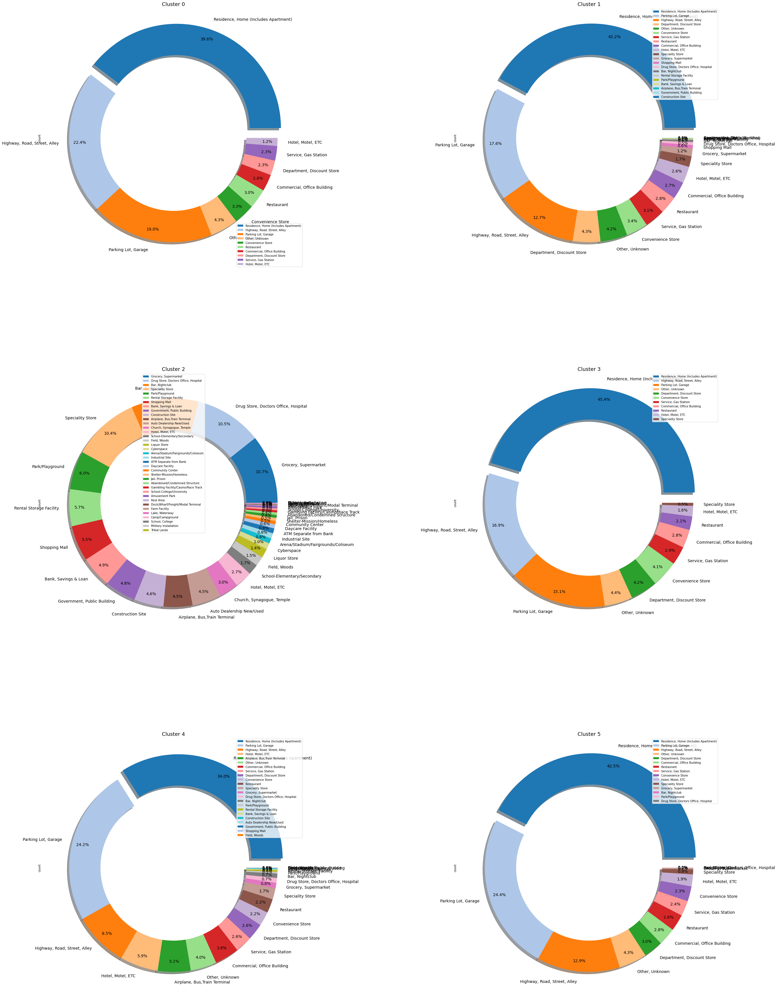

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from pyspark.sql.functions import col, desc
from pyspark.sql.window import Window

# Create a list of cluster numbers
cluster_nums = list(range(7))

# Define the number of rows and columns for the subplots
n_rows = 3
n_cols = 2

# Create the subplots
fig, axs = plt.subplots(n_rows, n_cols, figsize=(48, 64))
axs = axs.flatten()

# Iterate over each cluster number
for i, ax in zip(cluster_nums, axs):
    # Filter the DataFrame to get rows with the current cluster number
    tmp = count_6cluster.filter(col("cluster") == i)
    
    # Group by "Premise" and count the number of occurrences
    tmp = tmp.groupby("Premise").count().orderBy(desc("count"))
    
    # Convert the Spark DataFrame to a pandas DataFrame for plotting
    tmp = tmp.toPandas()

    # Emphasize the maximum segment
    explode = np.zeros(len(tmp))
    explode[0] = 0.1 if i in [0, 1, 3, 4, 5] else 0
 
    # Create a pie chart
    cmap = plt.get_cmap("tab20")
    outer_colors = cmap(np.arange(20))
    tmp.plot(kind="pie", y="count", ax=ax, colors=outer_colors, explode=explode, shadow=True, labels=tmp["Premise"], autopct="%1.1f%%", pctdistance=0.9, fontsize=14, wedgeprops={"width": 0.3})
    ax.set_title("Cluster {}".format(i), fontsize=18)
  
# Adjust the spacing between the subplots
plt.subplots_adjust(hspace=0.4)

# Show the plots
plt.show()


**Findings:**

> The pie charts that were generated for each cluster provide a useful way to analyze the categories within each group. It is clear that apart from Cluster 2, which covers the majority of data with a permise index larger than 10, the other clusters are primarily made up of three categories: "Residence, Home", "Parking lot", and "Highway, Road, Street, Alley". These three categories represent over 60% of the total data for each cluster.

> In more detail, "Residence, Home" is the largest category for all the clusters except for Cluster 2, and it makes up over 30% of the data in each cluster. "Parking lot" and "Highway, Road, Street, Alley" are the second and third most prominent categories. Cluster 2, on the other hand, has a fairly balanced distribution among its categories, with no dominant segments.

> Overall, this information provides insight into the types of locations where the incidents occurred, which can help guide future analyses and investigations. 

### 4.2.Time series prediction with SARIMA


####4.2.1.Time Data Prepartion and QC


In [ ]:
hou_crm_df = hou_crm_sdf.toPandas()

In [ ]:
hou_crm_df["Date"]=pd.to_datetime(hou_crm_df.Date)
hou_crm_df["New_date"] = hou_crm_df["Date"].dt.date
hou_crm_per_date = hou_crm_df.groupby('New_date')['Incident'].count().reset_index()
hou_crm_per_date.head()
# adding the date argument and parsing as a date field


,New_date,Incident
0,2019-01-01,685
1,2019-01-02,531
2,2019-01-03,553
3,2019-01-04,515
4,2019-01-05,547


In [ ]:
hou_crm_per_date.isnull().sum()

New_date    0
Incident    0
dtype: int64

In [ ]:
hou_crm_per_date['New_date'] = pd.to_datetime(hou_crm_per_date['New_date'])
hou_crm_per_date = hou_crm_per_date.set_index('New_date')

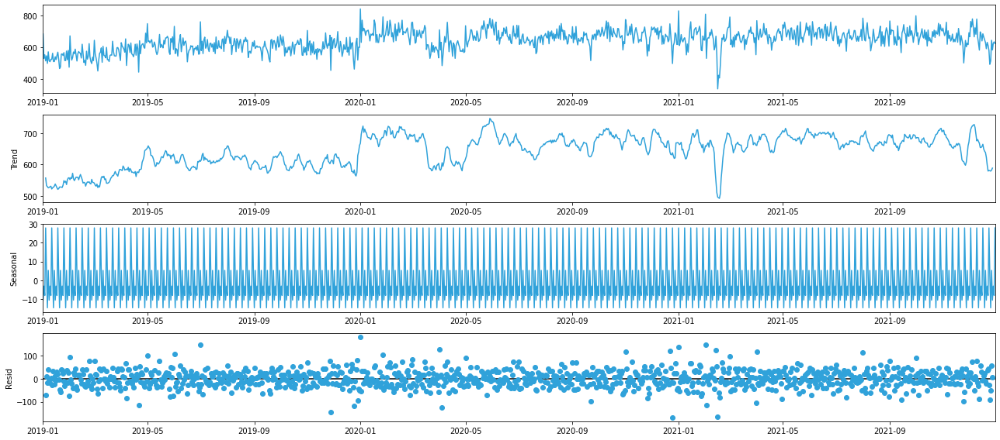

In [ ]:
from pylab import rcParams

rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(hou_crm_per_date, model='additive')
fig = decomposition.plot()
plt.show()

**Findings:**
> Above shows how to decompose a series into trend, seasonal, and residual components assuming an additive model.

> The time series presents a seasonality thus a SARIMA model is appropriate. In addition, the time series also presents an increasing trend.



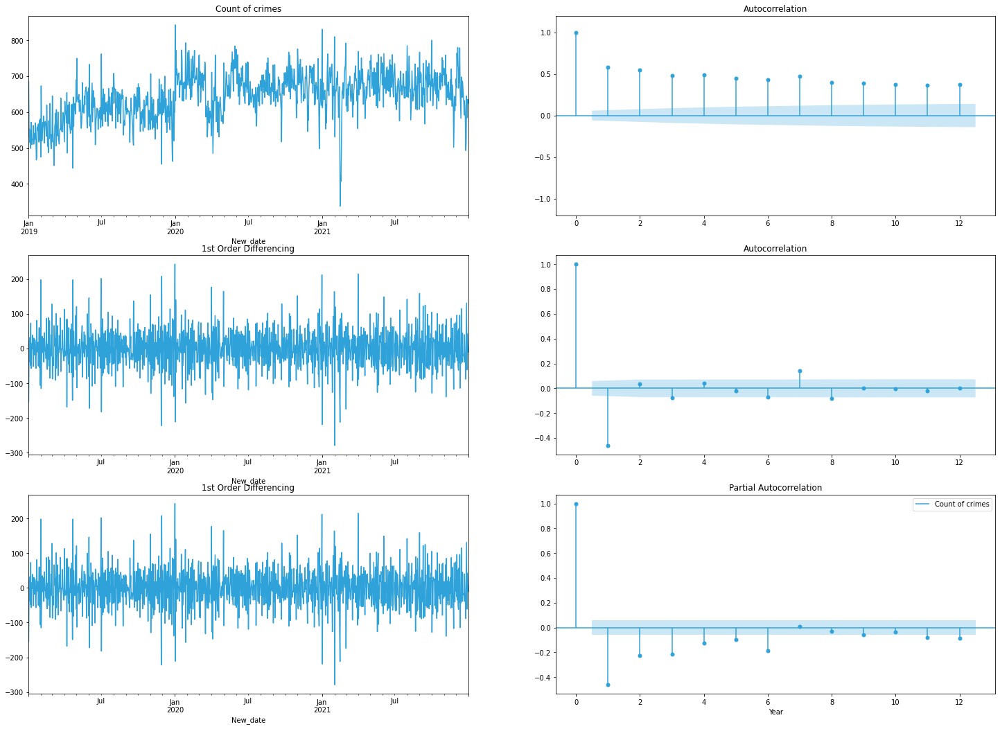

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
fig, axes = plt.subplots(nrows=3, ncols=2,figsize = (25,18))

hou_crm_per_date['Incident'].plot(ax=axes[0,0]);axes[0,0].set_title('Count of crimes')
hou_crm_per_date['Incident'].diff().dropna().plot(ax=axes[1,0]);axes[1,0].set_title('1st Order Differencing')
plot_acf(hou_crm_per_date['Incident'],lags =12,ax=axes[0,1]) ; axes[0,1].set_title('Autocorrelation')
plot_acf(hou_crm_per_date['Incident'].diff().dropna(), lags =12, ax=axes[1,1]); axes[1,1].set_title('Autocorrelation')
hou_crm_per_date['Incident'].diff().dropna().plot(ax=axes[2,0]);axes[2,0].set_title('1st Order Differencing')
plot_pacf(hou_crm_per_date['Incident'].diff().dropna(),lags = 12, ax=axes[2,1]); axes[2,1].set_title('Partial Autocorrelation')
axes[0,1].set(ylim = (-1.2,1.2))
plt.xlabel("Year")
plt.legend(['Count of crimes'])

**Findings:**

> Based on the given time series, it appears that first-order differencing is sufficient to achieve stationarity. 

> Additionally, the ACF and PACF plots of the differenced series indicate that there are only a few significant lags above the significance line.

> With regards to choosing the appropriate AR and MA orders for the model, a rough estimation based on the plots suggests a value of 1 for both p and q.



In [ ]:
from statsmodels.tsa.stattools import adfuller

def check_stationarity(ts):
    dftest = adfuller(ts)
    adf = dftest[0]
    pvalue = dftest[1]
    critical_value = dftest[4]['5%']
    if (pvalue < 0.05) and (adf < critical_value):
        print('The series is stationary')
    else:
        print('The series is NOT stationary')

check_stationarity(decomposition.seasonal)
check_stationarity(hou_crm_per_date.Incident)
check_stationarity(hou_crm_per_date['Incident'].diff().dropna())

The series is stationary
The series is stationary
The series is stationary


**Findings:**
> The time series is stationary, therefore it is reasonable to estimate that d = 0, indicating that no regular differencing is required to achieve stationarity.

> Since the seasonal component of the time series is also stationary, it can be estimated that D = 0, indicating that no seasonal differencing is required to achieve stationarity in the seasonal component.


/usr/local/lib/python3.8/dist-packages/statsmodels/regression/linear_model.py:1434: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


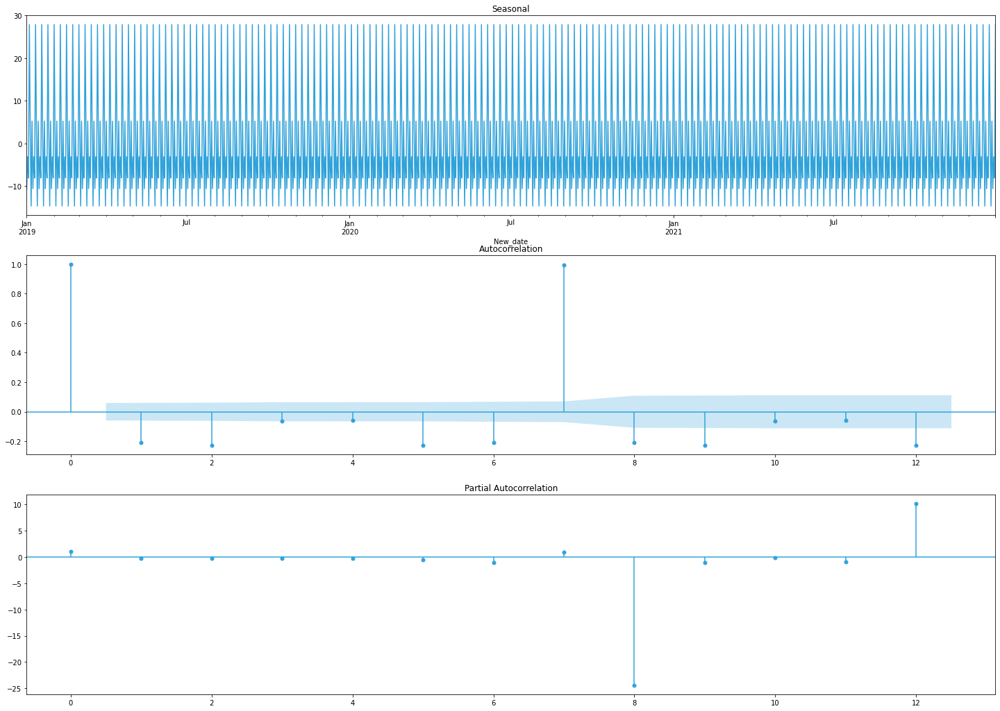

In [ ]:
fig, axes = plt.subplots(nrows=3, ncols=1,figsize = (25,18))

decomposition.seasonal.plot(ax=axes[0]);axes[0].set_title('Seasonal')
plot_acf(decomposition.seasonal,lags =12,ax=axes[1]) ; axes[1].set_title('Autocorrelation')
plot_pacf(decomposition.seasonal, lags =12,ax=axes[2]) ; axes[2].set_title('Partial Autocorrelation')
plt.show()

**Findings:**
> Based on the autocorrelation function (ACF) plot, the maximum positive lag with a value outside the confidence intervals is 7. Thus, a rough estimate for the seasonal autoregressive order (P) is 7. This value will be further evaluated in the next step.

> The partial autocorrelation function (PACF) plot shows that the minimum negative lag with a value outside the confidence intervals is 8. However, to avoid overfitting, we want to keep the parameter values as low as possible. Therefore, a rough estimate for the seasonal moving average order (Q) is 0. This value will also be evaluated in the next step.

> he combination of multiple parameter values will be tested, and the set of parameters that yield the lowest AIC value will be selected as the optimized parameters for the model.


####4.2.2.Model Training


In [ ]:
hou_crm_per_date.tail(1)

,Incident
New_date,
2021-12-31,625


In [ ]:
# splite the time seires into two parts: train and test sets.
train_crm_per_date = hou_crm_per_date.loc['2019-01-01':'2021-11-01'] 
print(train_crm_per_date.tail(1))
test_crm_per_date = hou_crm_per_date.loc['2021-11-02':'2022-01-01']
print(test_crm_per_date.head(1))

            Incident
New_date            
2021-11-01       722
            Incident
New_date            
2021-11-02       697


In [ ]:
# to reduce the run time, will estimate the optimized parameters sperately
# 1. estimate the (p,d,q)
import itertools
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(0,0,0, 12)]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[0], seasonal_pdq[0]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[0]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[0]))
print('SARIMAX: {} x {}'.format(pdq[3], seasonal_pdq[0]))
print (pdq)

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 0) x (0, 0, 0, 12)
SARIMAX: (0, 0, 1) x (0, 0, 0, 12)
SARIMAX: (0, 1, 0) x (0, 0, 0, 12)
SARIMAX: (0, 1, 1) x (0, 0, 0, 12)
[(0, 0, 0), (0, 0, 1), (0, 1, 0), (0, 1, 1), (1, 0, 0), (1, 0, 1), (1, 1, 0), (1, 1, 1)]


In [ ]:
min_aic = float('inf')
min_par = (0,0,0)
min_spar = (0,0,0)

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(train_crm_per_date,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False, fit_kw=dict(method='css'))
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
            if min_aic > results.aic:
              min_aic = results.aic
              min_par = param
              min_spar = param_seasonal
        except:
            continue
print('MIN ARIMA{}x{}12 - AIC:{}'.format(min_par, min_spar, min_aic))

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:16335.151211534057
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:15072.433555013879


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so in

ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:11357.565119068984
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:10925.658750396002
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:11374.332479878733


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so in

ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:10944.287937828383
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:11108.872555699214
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:10913.475736654898
MIN ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:10913.475736654898


**Findings**
> Based on the previous model fittings, the optimized ARIMA parameters were found to be (1,1,1), which resulted in the minimum AIC value of 10913.47. This is in agreement with the initial parameter estimate. Hence, the optimized parameters will be utilized in the upcoming seasonal_pdq tests.


In [ ]:
# 2. estimate the (P,D,Q)

p = d = q = 1,1,1
D = range(1, 2)
P = [0,7]
Q = [0,8]
pdq = [(1,1,1)]
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(P, D, Q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[0], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[0], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[0], seasonal_pdq[3]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (1, 1, 1) x (0, 1, 8, 12)
SARIMAX: (1, 1, 1) x (7, 1, 0, 12)
SARIMAX: (1, 1, 1) x (7, 1, 8, 12)


In [ ]:
min_aic = float('inf')
min_par = (0,0,0)
min_spar = (0,0,0)

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(train_crm_per_date,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False, fit_kw=dict(method='css'))
            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
            if min_aic > results.aic:
              min_aic = results.aic
              min_par = param
              min_spar = param_seasonal
        except:
            continue
print('MIN ARIMA{}x{}12 - AIC:{}'.format(min_par, min_spar, min_aic))


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:11504.352332599618


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


ARIMA(1, 1, 1)x(0, 1, 8, 12)12 - AIC:9813.967562057473


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


ARIMA(1, 1, 1)x(7, 1, 0, 12)12 - AIC:10040.205566742883


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


ARIMA(1, 1, 1)x(7, 1, 8, 12)12 - AIC:9827.14776704107
MIN ARIMA(1, 1, 1)x(0, 1, 8, 12)12 - AIC:9813.967562057473


**Comments:**
> The optimized SARIMA model has a minimum AIC value of 9813.96 with parameters (p,d,q)x(P,D,Q,M) as (1,1,1)x(0,1,8,12). This represents a significant improvement over the previous model with a reduction of about 10% in AIC value.






#### 4.2.3Model Evaluation


In [ ]:
mod = sm.tsa.statespace.SARIMAX(train_crm_per_date,
                                order=(1, 1, 1),
                                seasonal_order=(0 ,1, 8, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
train_results = mod.fit()
print(train_results.summary())

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/usr/local/lib/python3.8/dist-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                                                 SARIMAX Results                                                 
Dep. Variable:                                                  Incident   No. Observations:                 1036
Model:             SARIMAX(1, 1, 1)x(0, 1, [1, 2, 3, 4, 5, 6, 7, 8], 12)   Log Likelihood               -4895.984
Date:                                                   Sat, 25 Feb 2023   AIC                           9813.968
Time:                                                           19:34:53   BIC                           9867.095
Sample:                                                       01-01-2019   HQIC                          9834.236
                                                            - 11-01-2021                                         
Covariance Type:                                                     opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------

####4.2.4.Prediction

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:132: FutureWarning: The 'freq' argument in Timestamp is deprecated and will be removed in a future version.
  date_key = Timestamp(key, freq=base_index.freq)


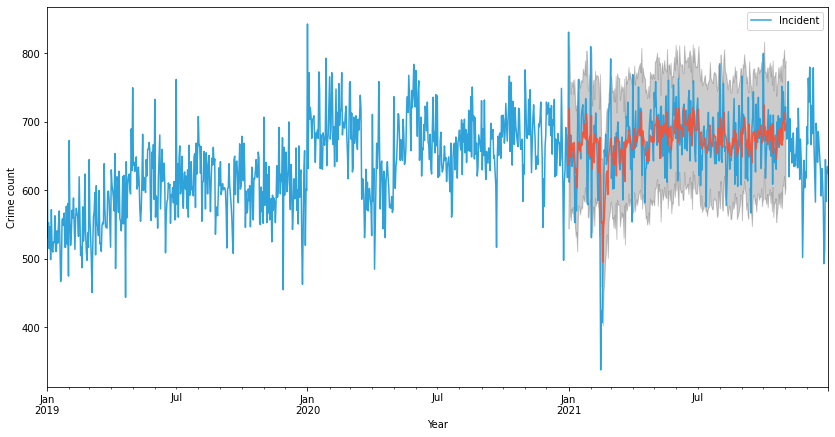

In [ ]:
pred= train_results.get_prediction(start=pd.to_datetime('2021-01-01'), dynamic=False)
pred_ci = pred.conf_int()
ax = hou_crm_per_date['2019':].plot(label='observed')
pred.predicted_mean.plot(ax=ax, label='Forecast', alpha=.9, figsize=(14, 7))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Year')
ax.set_ylabel('Crime count')
plt.show()

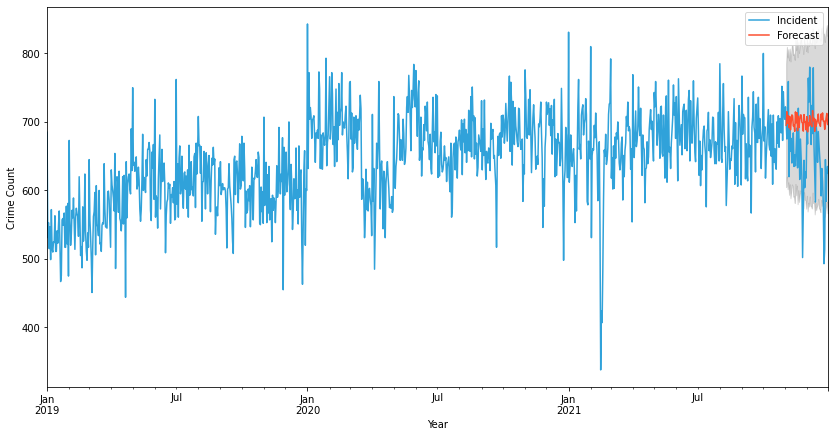

In [ ]:
pred_uc = train_results.get_forecast(steps=60)
pred_ci = pred_uc.conf_int()
ax = hou_crm_per_date.plot(label='observed', figsize=(14, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.15)
ax.set_xlabel('Year')
ax.set_ylabel('Crime Count')
plt.legend()
plt.show()

In [ ]:
from statsmodels.tools.eval_measures import rmse
test_prp = test_crm_per_date.shape[0]
test_res = train_results.forecast(steps=test_prp)

test_pred = train_results.get_forecast(steps=60).predicted_mean

nrmse = rmse(test_pred, test_crm_per_date.Incident)/(np.max(test_crm_per_date.Incident)-np.min(test_crm_per_date.Incident))
nrmse

0.25579555614673416

###4.3 LSTM

Perform a time series prediction using a Recurrent Neural Network regressor. 


####4.3.1 Time Data Prepartion

In [ ]:
import torch.nn as nn
import torch
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader

In [ ]:
from sklearn.preprocessing import MinMaxScaler

sc = MinMaxScaler(feature_range = (0, 1))

hou_crm_per_date_cl = np.array(hou_crm_per_date['Incident'].values)

hou_crm_per_date_cl = hou_crm_per_date_cl.reshape(-1, 1)

display(hou_crm_per_date_cl)
hou_crm_per_date_cl = sc.fit_transform(hou_crm_per_date_cl)
display(hou_crm_per_date_cl)

array([[685],
       [531],
       [553],
       ...,
       [626],
       [635],
       [625]])

array([[0.68712871],
       [0.38217822],
       [0.42574257],
       ...,
       [0.57029703],
       [0.58811881],
       [0.56831683]])

In [ ]:
display(dataset_cl)

array([[ 23.93],
       [ 24.25],
       [ 24.2 ],
       ...,
       [ 94.68],
       [104.56],
       [101.35]])

In [ ]:
#Create a function to process the data into 7 day look back slices
def processData(data, lb):
    X, Y = [], []
    for i in range(len(data) - lb - 1):
        X.append(data[i: (i + lb), 0])
        Y.append(data[(i + lb), 0])
    return np.array(X), np.array(Y)
X, y = processData(hou_crm_per_date_cl, 7)


In [ ]:
X_train, X_test = X[:int(X.shape[0]*0.80)],X[int(X.shape[0]*0.80):]
y_train, y_test = y[:int(y.shape[0]*0.80)],y[int(y.shape[0]*0.80):]
print(X_train.shape[0])
print(X_test.shape[0])
print(y_train.shape[0])
print(y_test.shape[0])

# reshaping
X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

870
218
870
218


####4.3.2 Model Training

In [ ]:
class RNN(nn.Module):
    def __init__(self, i_size, h_size, n_layers, o_size, dropout=0.1, bidirectional=True):
        super(RNN, self).__init__()
        self.num_directions = bidirectional+1
        self.rnn = nn.LSTM(
            input_size=i_size,
            hidden_size=h_size,
            num_layers=n_layers,
            dropout=dropout,
            bidirectional=bidirectional
        )
        self.out = nn.Linear(h_size, o_size)

    def forward(self, x, h_state):
        r_out, hidden_state = self.rnn(x, h_state)
        
        hidden_size = hidden_state[-1].size(-1)
        r_out = r_out.view(-1, self.num_directions, hidden_size)
        outs = self.out(r_out)
        
        return outs, hidden_state

In [ ]:
# Globals

INPUT_SIZE = 7
HIDDEN_SIZE = 64
NUM_LAYERS = 3
OUTPUT_SIZE = 1
BATCH_SIZE = 128
# Hyper parameters

learning_rate = 0.001
num_epochs = 300

rnn = RNN(INPUT_SIZE, HIDDEN_SIZE, NUM_LAYERS, OUTPUT_SIZE,bidirectional=False)
rnn.cuda()

optimiser = torch.optim.Adam(rnn.parameters(), lr=learning_rate)
criterion = nn.MSELoss()

hidden_state = None

In [ ]:
rnn

RNN(
  (rnn): LSTM(7, 64, num_layers=3, dropout=0.1)
  (out): Linear(in_features=64, out_features=1, bias=True)
)

In [ ]:
history = []
X_test_cuda = torch.tensor(X_test).float().cuda()
y_test_cuda = torch.tensor(y_test).float().cuda()

# we use all the data in one batch
inputs_cuda = torch.tensor(X_train).float().cuda()
labels_cuda = torch.tensor(y_train).float().cuda()

for epoch in range(num_epochs):
    rnn.train()
    output, _ = rnn(inputs_cuda, hidden_state) 
    # print(output.size())

    loss = criterion(output[:,0,:].view(-1), labels_cuda)
    optimiser.zero_grad()
    loss.backward()                     # back propagation
    optimiser.step()                    # update the parameters
    
    if epoch % 20 == 0:
        rnn.eval()
        test_output, _ = rnn(X_test_cuda, hidden_state)
        test_loss = criterion(test_output.view(-1), y_test_cuda)
        print('epoch {}, loss {}, eval loss {}'.format(epoch, loss.item(), test_loss.item()))
    else:
        print('epoch {}, loss {}'.format(epoch, loss.item()))
    history.append(loss.item())

epoch 0, loss 0.29352813959121704, eval loss 0.33034548163414
epoch 1, loss 0.262452632188797
epoch 2, loss 0.23206351697444916
epoch 3, loss 0.20021604001522064
epoch 4, loss 0.16775688529014587
epoch 5, loss 0.13351121544837952
epoch 6, loss 0.09800488501787186
epoch 7, loss 0.06322166323661804
epoch 8, loss 0.03137261047959328
epoch 9, loss 0.014034413732588291
epoch 10, loss 0.02729393169283867
epoch 11, loss 0.04994593560695648
epoch 12, loss 0.04685186222195625
epoch 13, loss 0.033770158886909485
epoch 14, loss 0.020873654633760452
epoch 15, loss 0.014960953034460545
epoch 16, loss 0.014089533127844334
epoch 17, loss 0.016364112496376038
epoch 18, loss 0.01947668567299843
epoch 19, loss 0.02181866578757763
epoch 20, loss 0.02361772395670414, eval loss 0.038589220494031906
epoch 21, loss 0.024281412363052368
epoch 22, loss 0.023467671126127243
epoch 23, loss 0.022353164851665497
epoch 24, loss 0.02073737420141697
epoch 25, loss 0.018712583929300308
epoch 26, loss 0.016505261883139

In [ ]:
rnn.out.weight 

Parameter containing:
tensor([[-0.0510,  0.0245,  0.1331, -0.0635, -0.1248,  0.0338, -0.0668,  0.1312,
          0.1061,  0.0012, -0.0567, -0.0608, -0.0303,  0.0251,  0.0116, -0.0705,
          0.1172,  0.0763,  0.0122,  0.0120, -0.0135, -0.0503, -0.1327, -0.1174,
         -0.0402, -0.0012,  0.0663,  0.0026,  0.0374,  0.0361, -0.1161, -0.0865,
          0.0449,  0.1119, -0.0103,  0.0325, -0.0575, -0.0152,  0.0324,  0.0242,
          0.0571, -0.0337, -0.1041,  0.1146,  0.0862,  0.0179,  0.1249, -0.0469,
          0.0212,  0.0623, -0.0517,  0.0565, -0.0137,  0.0956, -0.0186, -0.1148,
          0.0241,  0.0480, -0.1110, -0.0033, -0.0935, -0.0886, -0.0434,  0.0719]],
       device='cuda:0', requires_grad=True)

In [ ]:
for param in rnn.parameters():
    print(param.data)

tensor([[ 0.0265, -0.0719, -0.0864,  ...,  0.1200,  0.1488, -0.0650],
        [ 0.0776,  0.1015, -0.0210,  ...,  0.0815,  0.0867,  0.0916],
        [-0.0644,  0.1240,  0.0777,  ...,  0.0636,  0.0862,  0.0206],
        ...,
        [ 0.0020,  0.0940,  0.0297,  ..., -0.0400, -0.0518, -0.0614],
        [-0.1176, -0.0231,  0.0379,  ..., -0.0500,  0.0941, -0.0721],
        [-0.0074, -0.0264, -0.1105,  ...,  0.0784, -0.0317, -0.0215]],
       device='cuda:0')
tensor([[-0.0117, -0.0163,  0.0185,  ...,  0.0095, -0.0690, -0.0069],
        [-0.1029,  0.0012,  0.0005,  ..., -0.0686, -0.1324, -0.0018],
        [ 0.0023,  0.0689,  0.1589,  ...,  0.1603,  0.0373, -0.0162],
        ...,
        [ 0.1135, -0.0291,  0.0285,  ..., -0.0672, -0.0040, -0.1290],
        [-0.0585, -0.0726,  0.0980,  ...,  0.0483, -0.1014, -0.0980],
        [-0.0098, -0.0528, -0.1287,  ...,  0.0587, -0.0215,  0.0766]],
       device='cuda:0')
tensor([ 0.0987, -0.0543,  0.1820, -0.0501, -0.0511,  0.0447,  0.0897, -0.0332,
    

####4.3.2 Model Evaluation 


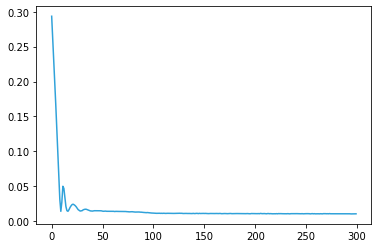

In [ ]:
plt.plot(history)
# dplt.plot(history.history['val_loss'])

####4.3.3 Model Prediction

In [ ]:
X_test[0]

array([[0.63960396, 0.83762376, 0.62970297, 0.64356436, 0.58217822,
        0.65544554, 0.69108911]])

In [ ]:
# X_train_X_test = np.concatenate((X_train, X_test),axis=0)
# hidden_state = None
rnn.eval()
# test_inputs = torch.tensor(X_test).float().cuda()
test_predict, _ = rnn(X_test_cuda, hidden_state)
test_predict_cpu = test_predict.cpu().detach().numpy()

In [ ]:
test_predict_cpu.shape

(218, 1, 1)

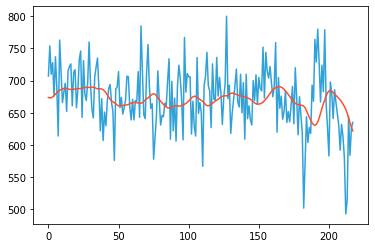

In [ ]:
plt.plot(sc.inverse_transform(y_test.reshape(-1,1)))
plt.plot(sc.inverse_transform(test_predict_cpu.reshape(-1,1)))

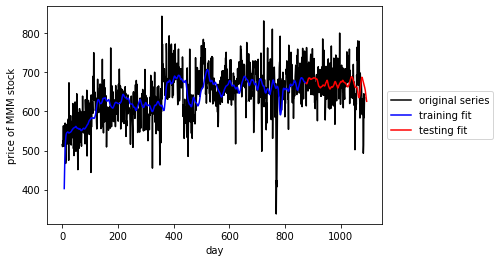

In [ ]:
# plot original data
plt.plot(sc.inverse_transform(y.reshape(-1,1)), color='k')

# train_inputs = torch.tensor(X_train).float().cuda()
train_pred, hidden_state = rnn(inputs_cuda, None)
train_pred_cpu = train_pred.cpu().detach().numpy()

# use hidden state from previous training data
test_predict, _ = rnn(X_test_cuda, hidden_state)
test_predict_cpu = test_predict.cpu().detach().numpy()

# plt.plot(scl.inverse_transform(y_test.reshape(-1,1)))
split_pt = int(X.shape[0] * 0.80) + 7 # window_size
plt.plot(np.arange(7, split_pt, 1), sc.inverse_transform(train_pred_cpu.reshape(-1,1)), color='b')
plt.plot(np.arange(split_pt, split_pt + len(test_predict_cpu), 1), sc.inverse_transform(test_predict_cpu.reshape(-1,1)), color='r')

# pretty up graph
plt.xlabel('day')
plt.ylabel('price of MMM stock')
plt.legend(['original series','training fit','testing fit'], loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


In [ ]:
from statsmodels.tools.eval_measures import rmse
test_prp = sc.inverse_transform(y_test.reshape(-1,1)).T[0]
test_res = sc.inverse_transform(test_predict_cpu.reshape(-1,1)).T[0]

nrmse = rmse(test_res, test_prp)/(np.max(test_prp)-np.min(test_prp))
nrmse

##5. Conclusion:

After analyzing the 2019-2021 crime in Houston, several trends have emerged. Overall, there has been a decrease in the crime rate for certain types of crimes such as credit card fraud, embezzlement, theft from motor vehicles, and simple assault. However, other types of crime such as murder and weapon law violations have seen an increase. The increase in these more violent crimes is concerning, and further analysis is needed to determine the underlying causes.

One notable finding is that homicide crimes tend to occur more frequently on weekends, particularly Saturday and Sunday. Additionally, the majority of homicides occur during late hours, between 7pm and 12pm. This information could be useful in identifying areas and times when law enforcement presence may need to be increased to prevent or reduce violent crimes.

Through visual analysis of crime data, it is clear that certain zip codes in Houston have higher crime rates than others. In particular, zip codes 77036 and 77021 have been identified as dangerous neighborhoods in Houston. The crime heat map also reveals that downtown and uptown areas have the highest crime intensity in the city.

Cluster analysis of crime data has identified five clusters, with cluster 3 covering the majority of data. The pie chart analysis shows that residence/home accounts for more than 40% of the remaining four clusters, with parking lots and highways/roads/streets/alleys accounting for the second and third highest contributions.

Based on the analysis, the optimized SARIMA model with seasonal terms has provided a good fit for the Houston crime data. The minimum AIC value of 9813.96 with optimized parameters indicates that the model has a good balance between fit and complexity. The reduction in AIC value by about 10% suggests that the addition of the seasonal terms has improved the model's ability to capture the underlying patterns in the data.

he optimized SARIMA model showed a good level of accuracy in predicting crime trends in Houston. The NRMS value of 0.256 indicated that the model's forecast error rate was approximately 26%. This means that the SARIMA model can be relied upon to provide reasonably accurate forecasts of future crime rates.

However, when compared to the LSTM model, which has an NRMS value of 0.15, the SARIMA model was found to be less accurate. This suggests that the LSTM model is a more suitable approach for predicting crime trends in Houston.
